In [1]:
import sys
sys.path.append("C:/Users/brusl/Documents/1 Escuela/1 Universidad/8 semestre/Procesamiento digital de Imágenes/Practicas_PDI")
from imutils import *
import cv2
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
from matplotlib import cm
from scipy.ndimage.filters import *
import numpy as np
from numpy.fft import fft2, fftshift, ifft2,ifftshift
image_monkey=cv2.imread("C:/Users/brusl/Pictures/Imagenes_Opencv/monkey.jpg",0)
xs,ys=image_monkey.shape

# Capítulo 4
### Ejercicio 2
En este ejercicio se trabajará con la Transformada de Fourier y la parte mas importante es la visualización de la misma en dos situaciones diferentes, con desplazamiento y sin desplazamiento.
1. Crear un arreglo que se pueda ver como la imagen que tenga fondo blanco y una franja de valores de negro. La imagen debe ser de tamaño (100, 100) y en el intervalo de [45 : 55, 25 : 75] = 0.
2. Mostrar la imagen
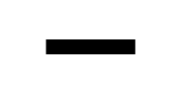


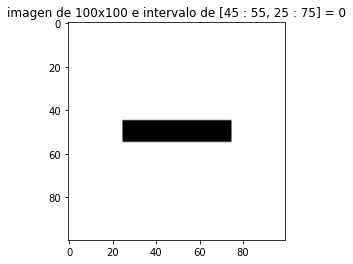

In [51]:
x=np.pad(np.full((10, 50), 0), pad_width=((45,45),(25,25)), constant_values=1)
plt.imshow(x,cmap="gray"),plt.title("imagen de 100x100 e intervalo de [45 : 55, 25 : 75] = 0")
plt.show()

3. Calcular la transformada de Fourier con fft2 ponderada y sin ponderar 
    - Sin desplazar : Obtener el valor absoluto o espectro de potencia de la Transformada de Fourier

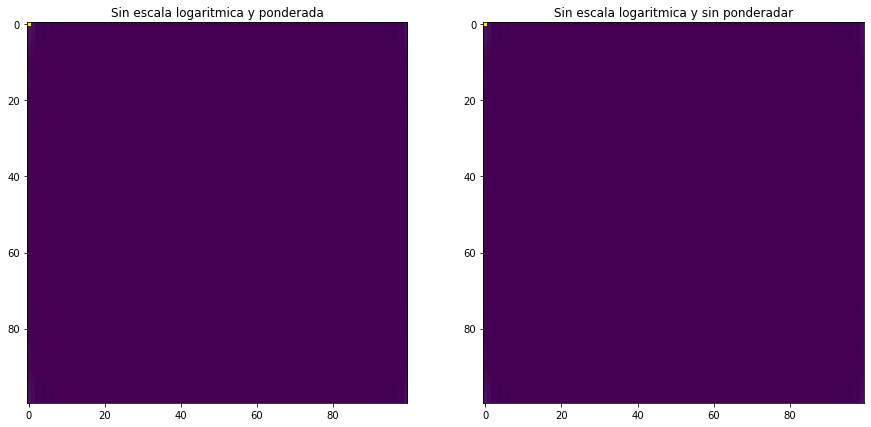

In [54]:
H,W = np.shape(x)
F = fft2(x)/(W*H)  
Fpon=abs(F)
Fsp= fft2(x)
F = fftshift(F)
P =np.log(1+np.abs(F)) 
P1 =np.abs(F) 
Fspon=abs(fft2(x))
fig = plt.figure(figsize=(15, 15));rows,columns = 1,2# crear figura, establecer los valores del tamaño de los subplots
#agregar a los subplots las imagenes.
fig.add_subplot(rows, columns, 1),plt.imshow(Fpon),plt.title("Sin escala logaritmica y ponderada")
fig.add_subplot(rows, columns, 2),plt.imshow(Fspon),plt.title("Sin escala logaritmica y sin ponderadar")
plt.show()

4. Visualizar el espectro de la transformada de Fourier en escala logarítmica y sin escala logaritmica. Defina una ventana que permita analizar la transformada de Fourier

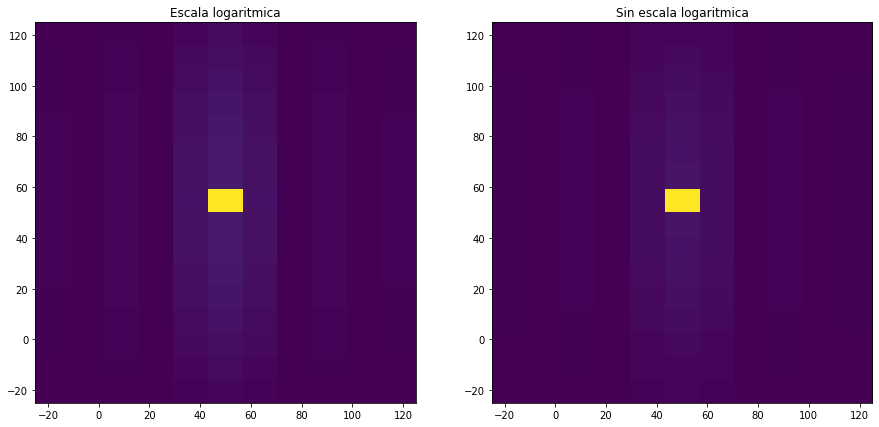

In [4]:
fig = plt.figure(figsize=(15, 30));rows,columns = 1,2# crear figura, establecer los valores del tamaño de los subplots
#agregar a los subplots las imagenes.
fig.add_subplot(rows, columns, 1),plt.imshow(P[43:59,45:56],extent=[-25,125,-25,125]),plt.title("Escala logaritmica")
fig.add_subplot(rows, columns, 2),plt.imshow(P1[43:59,45:56],extent=[-25,125,-25,125]),plt.title("Sin escala logaritmica")
plt.show()

5. Mostrar la imagen original y la transformada de Fourier


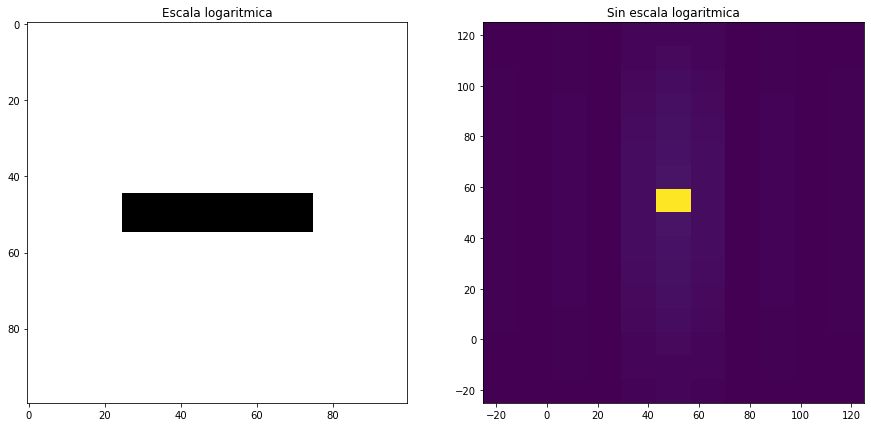

In [5]:
fig = plt.figure(figsize=(15, 30));rows,columns = 1,2# crear figura, establecer los valores del tamaño de los subplots
#agregar a los subplots las imagenes.
fig.add_subplot(rows, columns, 1),plt.imshow(x,cmap="gray"),plt.title("Escala logaritmica")
fig.add_subplot(rows, columns, 2),plt.imshow(P1[43:59,45:56],extent=[-25,125,-25,125]),plt.title("Sin escala logaritmica")
plt.show()

6. Recuperar la imagen original usando ifft2
    - Desplazar: Obtener el valor absoluto o espectro de potencia de la Transformada de Fourier
    - Visualizar el espectro de la transformada de Fourier desplazada en escala logarítmica. Defina una ventana que permita analizar la transformada de Fourier
    - Recuperar la imagen original usando ifft2
7. En ambos casos mostrar la imagen original y la transformada de Fourier desplazada.
8. Concluya al respecto al visualizar ambos resultados.
9. Se sugiere consultar : https://bit.ly/2KgWJf9, tenga presente que en el ejemplo se usa la interfaz Jupyter Notebook.

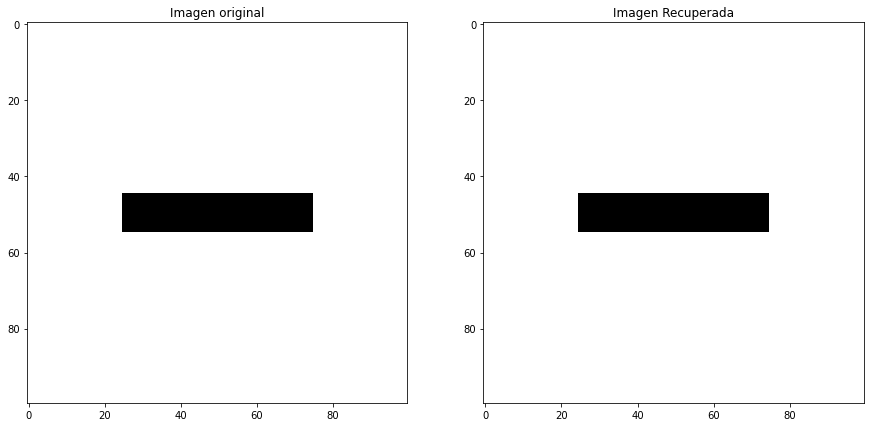

In [6]:
f_ishift = ifftshift(F)
img_back = np.fft.ifft2(f_ishift)
img_back = np.real(img_back)
fig = plt.figure(figsize=(15, 30));rows,columns = 1,2# crear figura, establecer los valores del tamaño de los subplots
#agregar a los subplots las imagenes.
fig.add_subplot(rows, columns, 1),plt.imshow(x,cmap="gray"),plt.title("Imagen original")
fig.add_subplot(rows, columns, 2),plt.imshow(img_back,cmap="gray"),plt.title("Imagen Recuperada")
plt.show()

### Ejercicio 3
Para el ejercicio se deben generar dos imágenes que equivalen a un foco luminoso al centro y un círculo negro, algo similar a lo que se muestra:
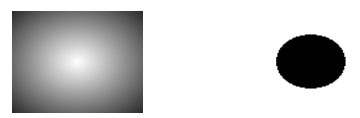

1. Obtener la Transformada Discreta de Fourier del foco luminoso y el circulo negro en |F(0,0)| .

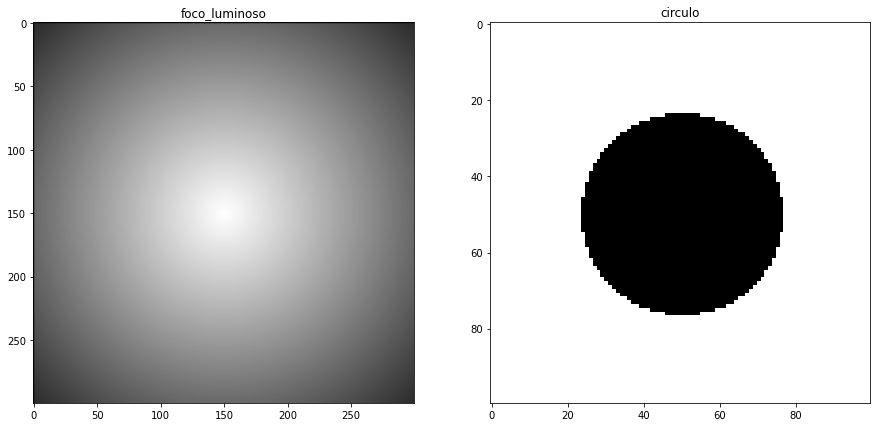

In [7]:
a=foco_luminoso()
b=circulo()
fig = plt.figure(figsize=(15, 30));rows,columns = 1,2# crear figura, establecer los valores del tamaño de los subplots
#agregar a los subplots las imagenes.
fig.add_subplot(rows, columns, 1),plt.imshow(a,cmap="gray"),plt.title("foco_luminoso")
fig.add_subplot(rows, columns, 2),plt.imshow(b,cmap="gray"),plt.title("circulo")
plt.show()

2. Visualizar la imagen original y el espectro de la transformada de Fourier, usando la escala logarítmica y sin usar la escala lograítmica
    - sin usar la escala lograítmica

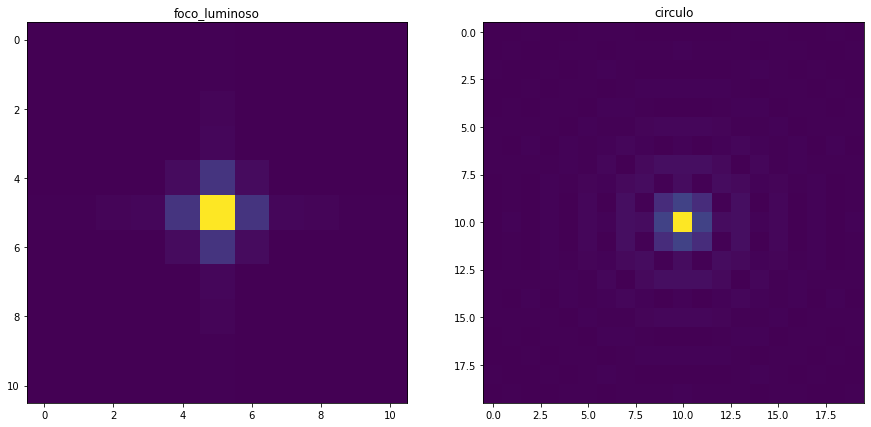

In [8]:
H,W = np.shape(a)
H1,W1 = np.shape(b)
F = np.abs(fft2(a)/(W*H))
F1 = np.abs(fft2(b)/(W*H))
F = fftshift(F)
F1 = fftshift(F1)
fig = plt.figure(figsize=(15, 30));rows,columns = 1,2# crear figura, establecer los valores del tamaño de los subplots
#agregar a los subplots las imagenes.
fig.add_subplot(rows, columns, 1),plt.imshow(F[145:156,145:156]),plt.title("foco_luminoso")
fig.add_subplot(rows, columns, 2),plt.imshow(F1[40:60,40:60]),plt.title("circulo")
plt.show()

- usando la escala lograítmica

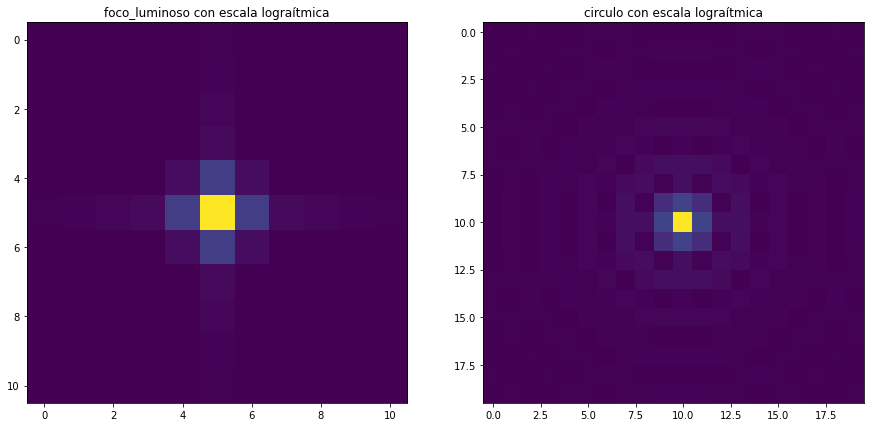

In [9]:
c=20
P =c*np.log(1+np.abs(F)) 
P1=c*np.log(1+np.abs(F1)) 
fig = plt.figure(figsize=(15, 30));rows,columns = 1,2# crear figura, establecer los valores del tamaño de los subplots
#agregar a los subplots las imagenes.
fig.add_subplot(rows, columns, 1),plt.imshow(P[145:156,145:156]),plt.title("foco_luminoso con escala lograítmica")
fig.add_subplot(rows, columns, 2),plt.imshow(P1[40:60,40:60]),plt.title("circulo con escala lograítmica")
plt.show()

# Capítulo 5
### Ejercicio 0
A continuación se solicta que se grafiquen los filtros pasabajas y pasa altas ideales , utilizando la herramienta MatplotLib con Python
1. Visualizar en 2D y 3D el filtro pasabajos ideal para 2 frecuencias de corte 
    - 5

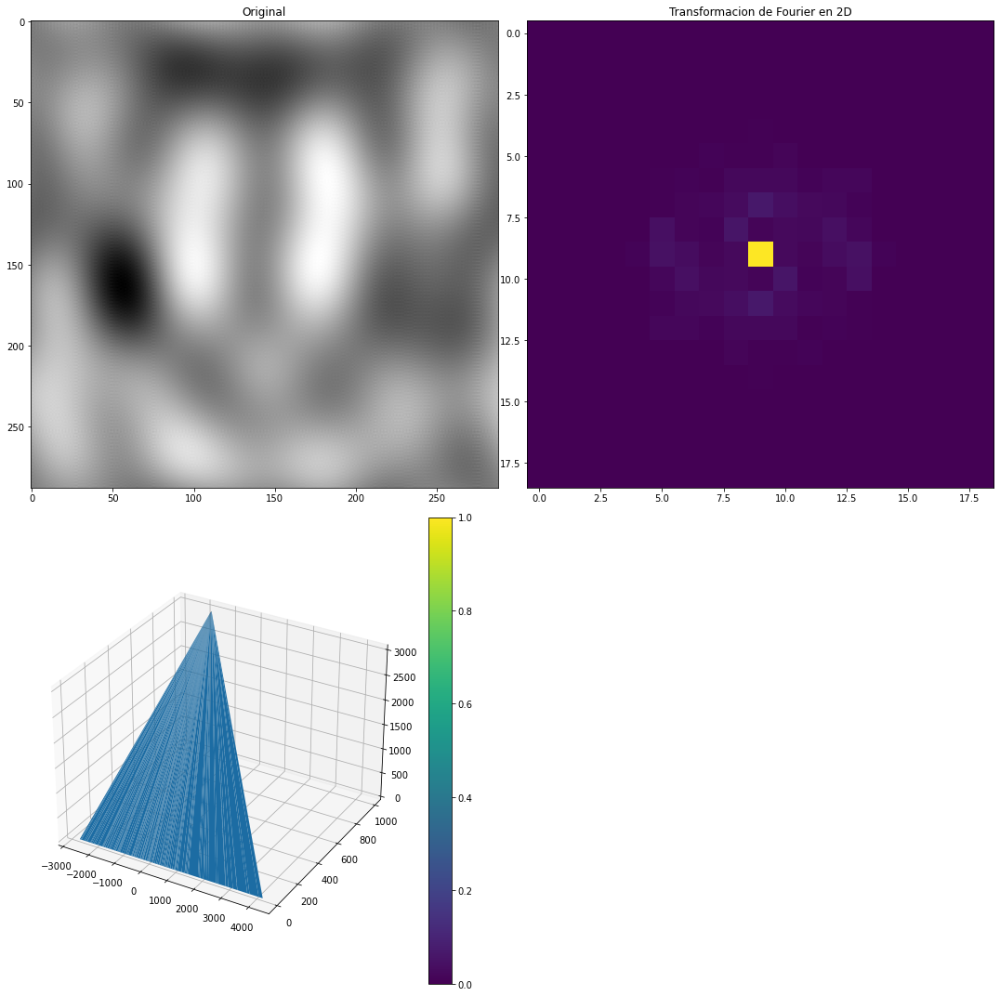

In [10]:
f, con=ideal_lw_filters(image_monkey,5)
Put_3d(f, con)

- 20 respectivamente.

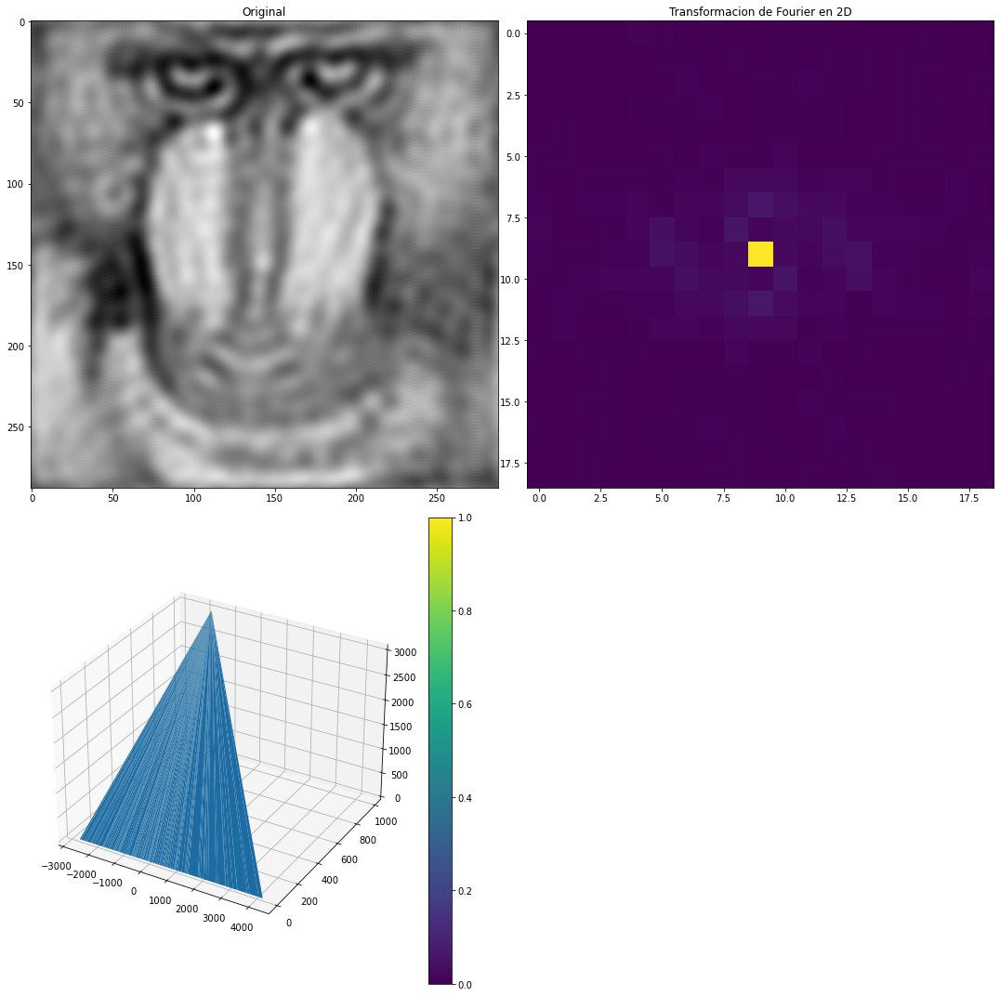

In [13]:
f3, con3=ideal_lw_filters(image_monkey,20)
Put_3d(f3, con3)

2. Visualizar en 2D y 3D el filtro pasaaltas ideal para 2 frecuencias de corte 
    - 5

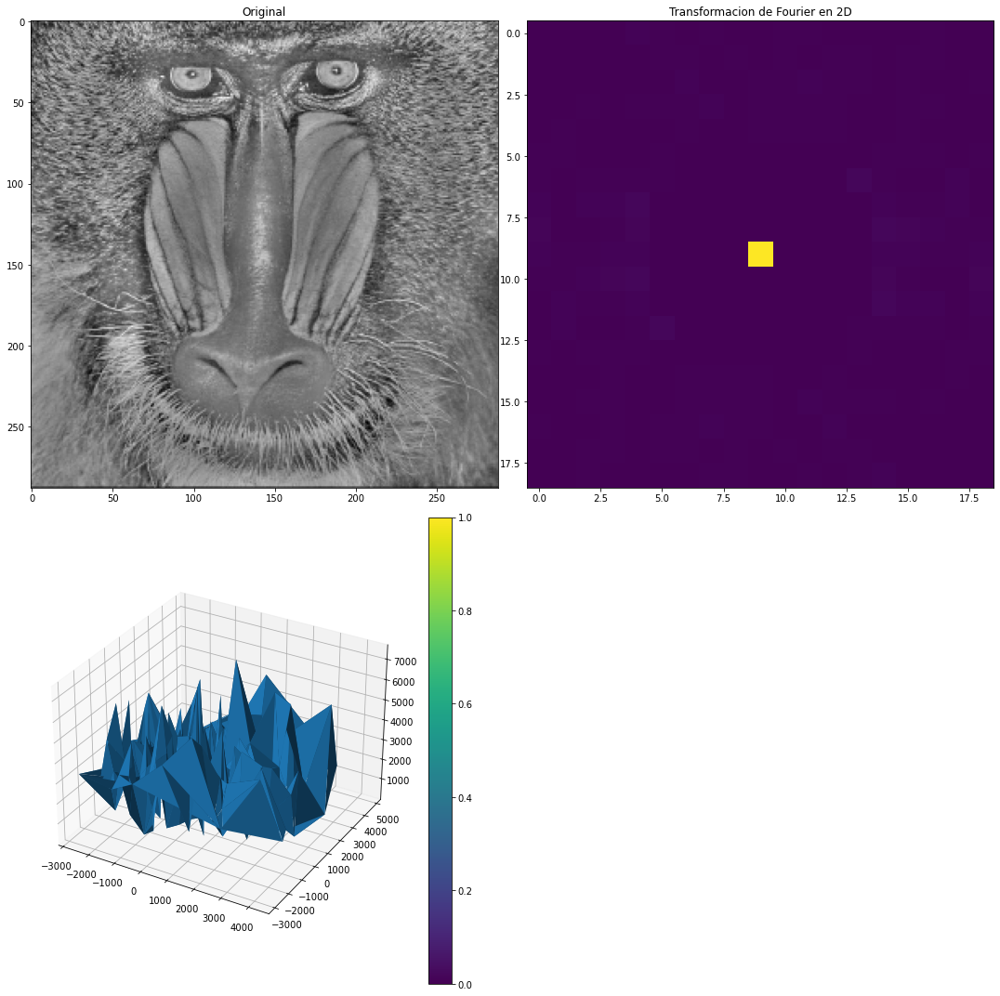

In [14]:
h, htrmfd=ideal_hgh_filt(image_monkey,5)
Put_3d(h, htrmfd)

- 20

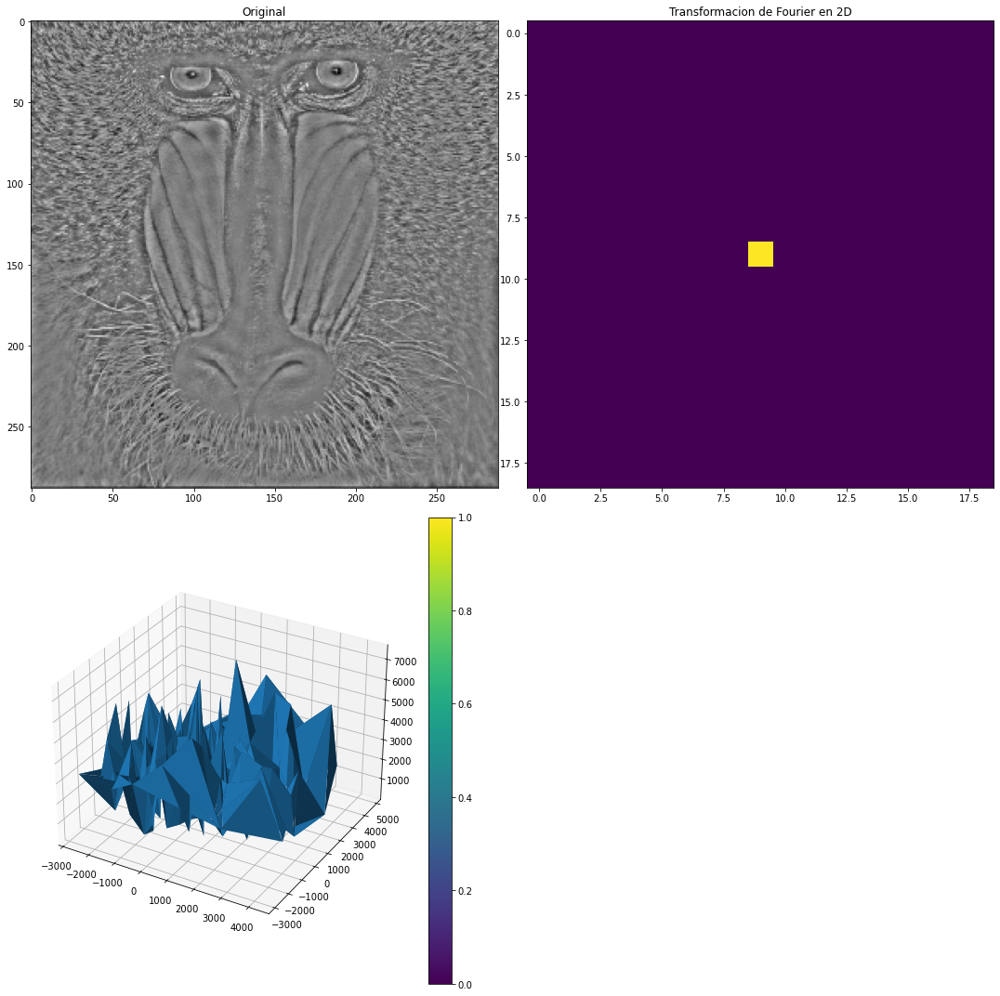

In [17]:
h3, htrmfd3=ideal_hgh_filt(image_monkey,20)
Put_3d(h3, htrmfd3)

3. Visualizar en 2D el filtro de Butterworth, grado 2 para 4 frecuencias de corte 
    - 5

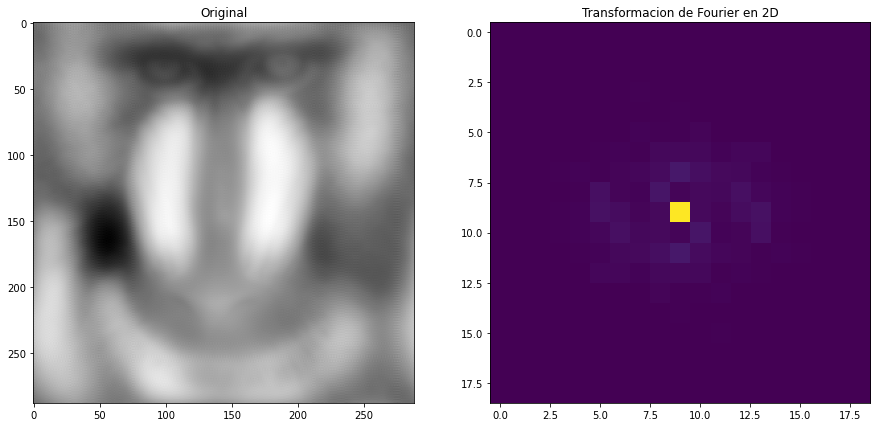

In [18]:
btt, btrfmd=ideal_butterworth(image_monkey,5)
Put_only2D(btt, btrfmd)

- 10

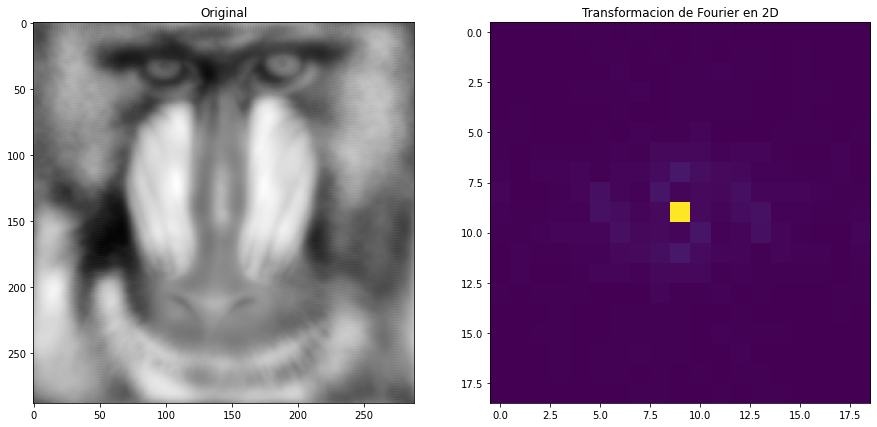

In [19]:
btt1, btrfmd1=ideal_butterworth(image_monkey,10)
Put_only2D(btt1, btrfmd1)

- 15

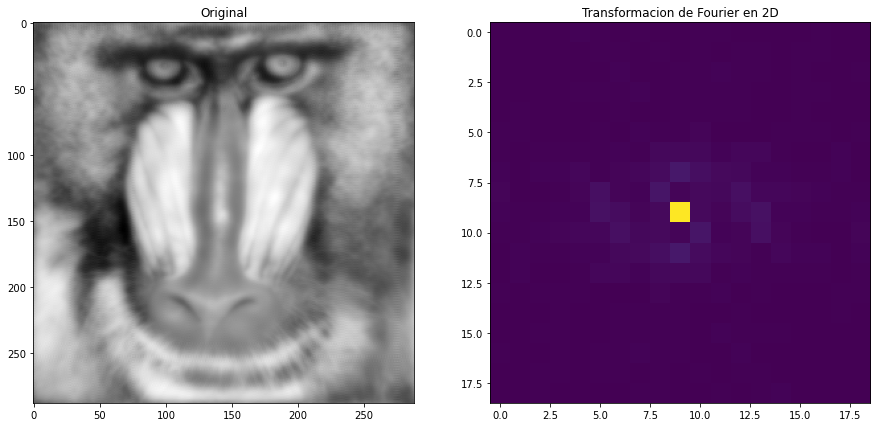

In [20]:
btt2, btrfmd2=ideal_butterworth(image_monkey,15)
Put_only2D(btt2, btrfmd2)

- 20 respectivamente.

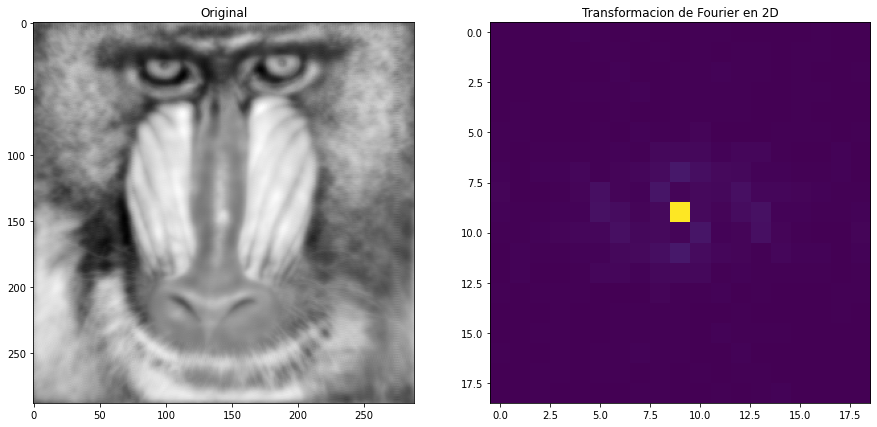

In [21]:
btt3, btrfmd3=ideal_butterworth(image_monkey,20)
Put_only2D(btt3, btrfmd3)

### Ejercicio 1
1. 6.5.1 Ideal Lowpass Filter . . . . . . . . . . . . ,120

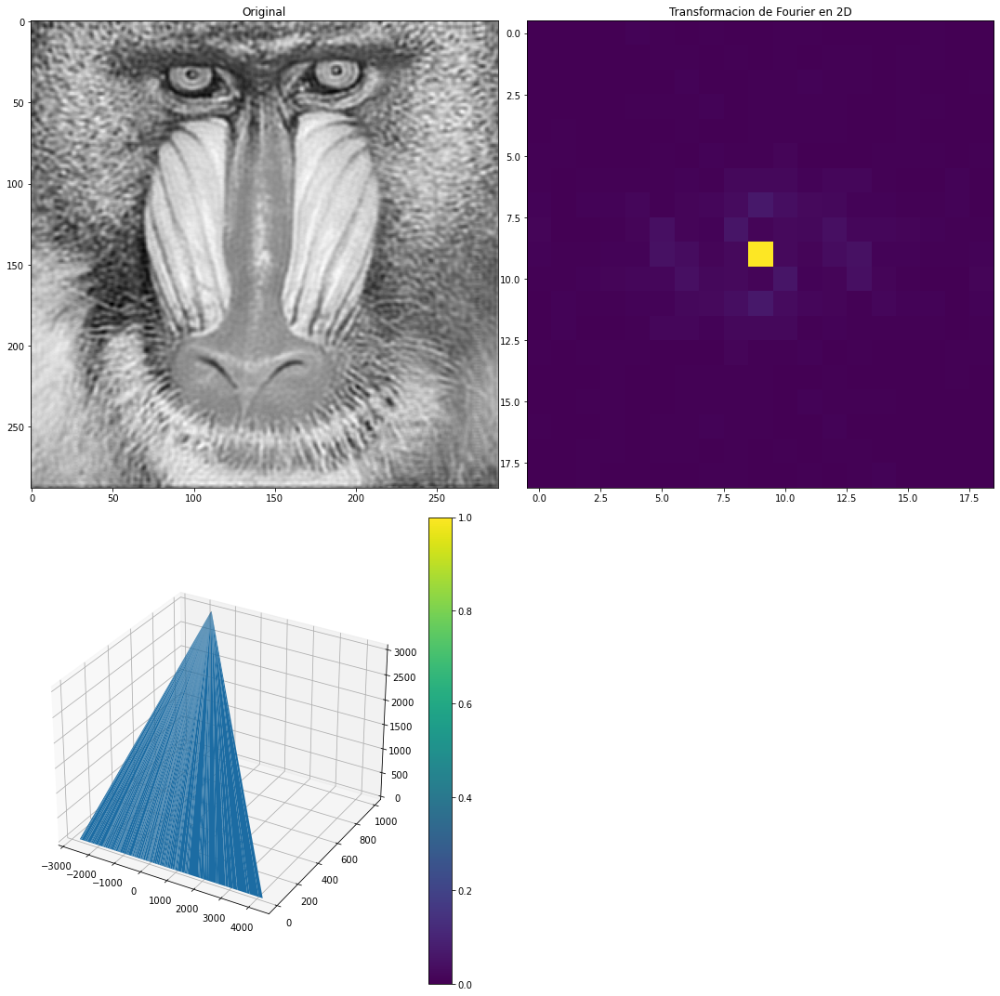

In [22]:
f3, con3=ideal_lw_filters(image_monkey,80)
Put_3d(f3, con3)

2. 6.5.2 Butterworth Lowpass Filter . . . . . . 123

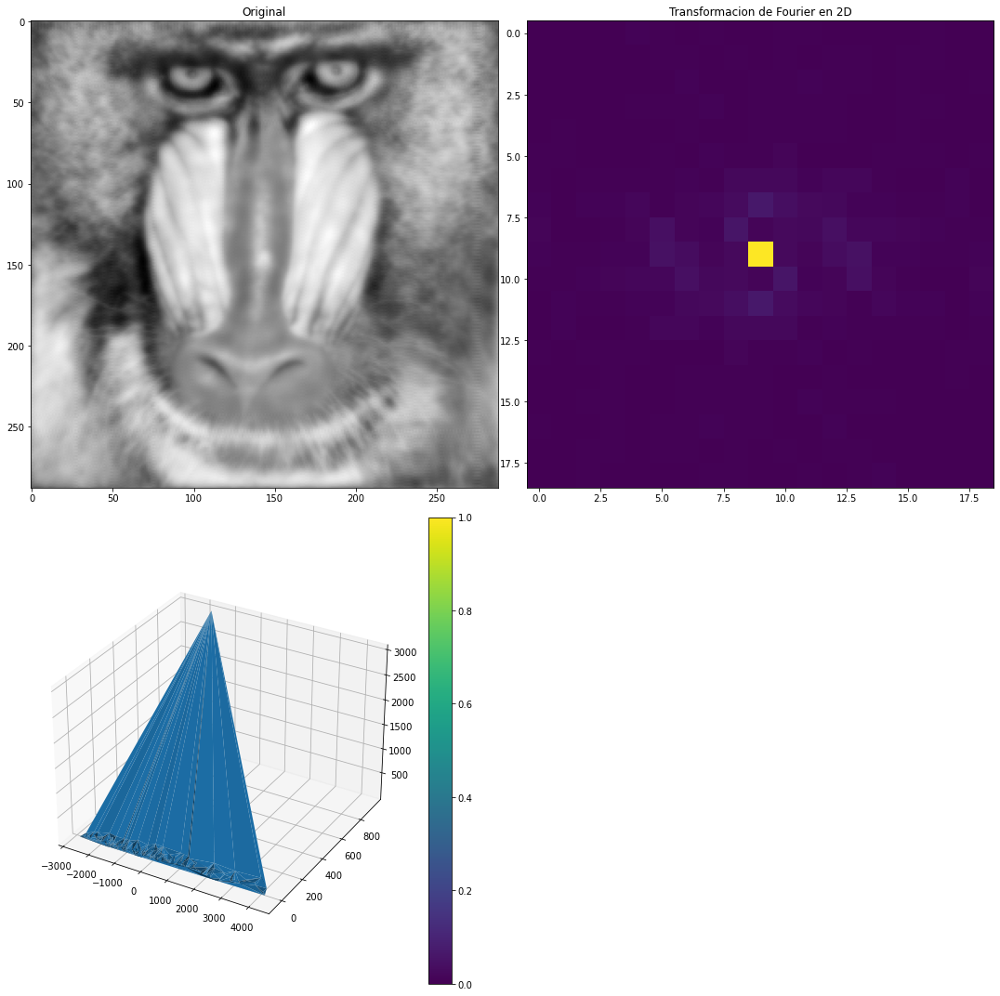

In [23]:
btt3, btrfmd3=ideal_butterworth(image_monkey,20)
Put_3d(btt3, btrfmd3)

3. 6.5.3 Gaussian Lowpass Filter . . . . . . . . . 125

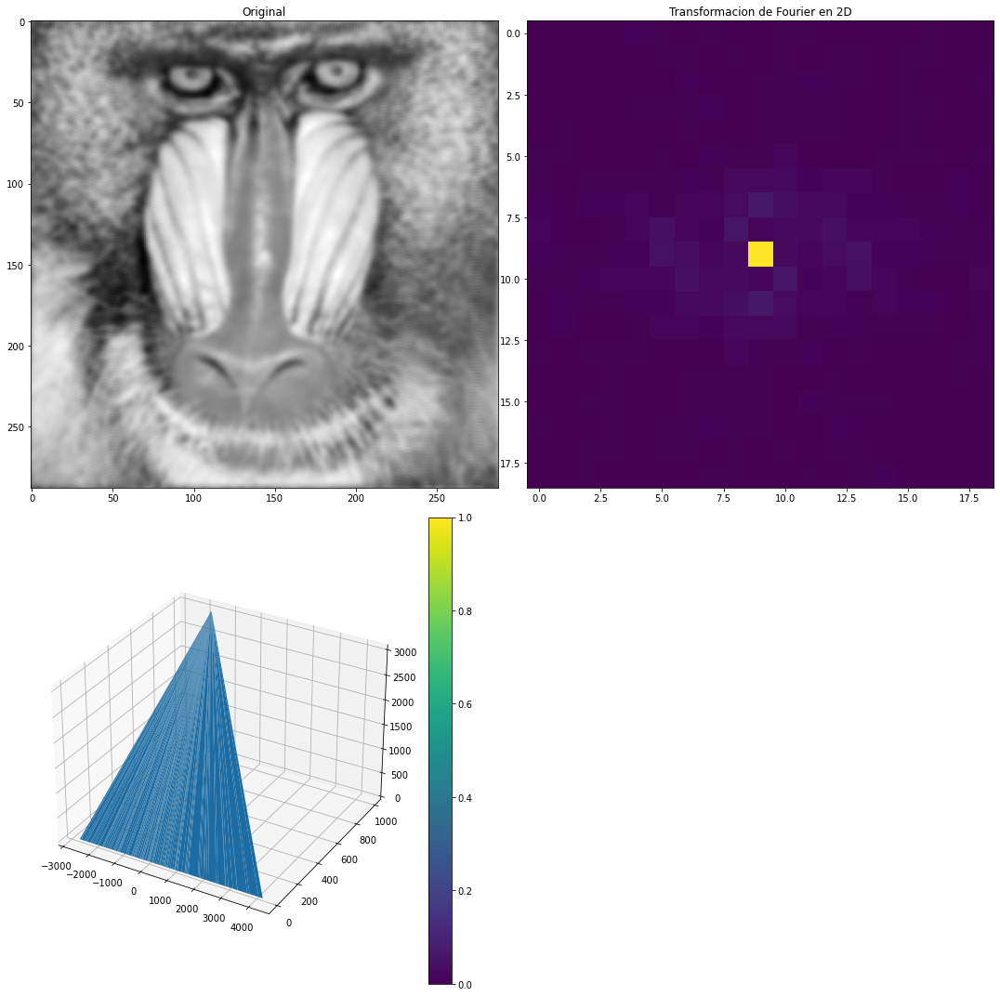

In [24]:
gauss,gtr=gauss_lw_filt(image_monkey,20)
Put_3d(gauss, gtr)

4. 6.5.4 Ideal Highpass Filter . . . . . . . . . . . . 127

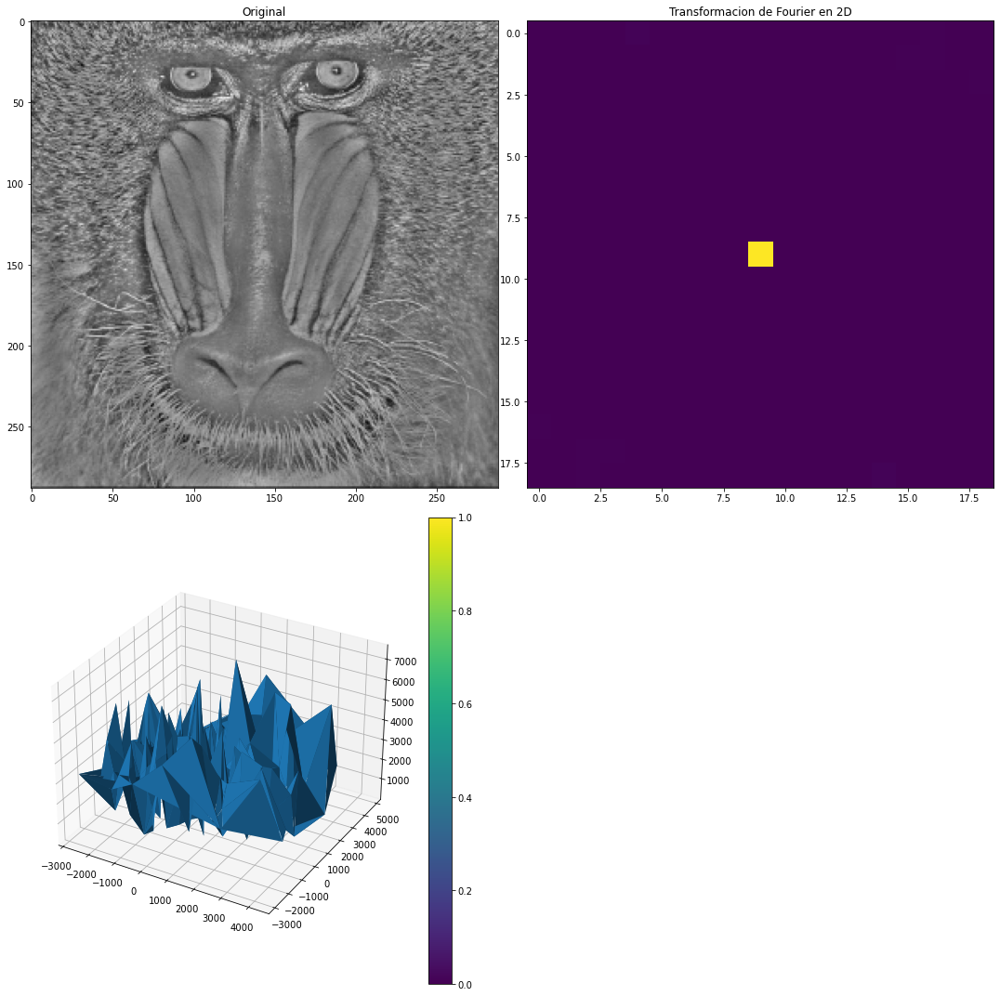

In [25]:
h1, htrmfd1=ideal_hgh_filt(image_monkey,10)
Put_3d(h1, htrmfd1)

5. 6.5.5 Butterworth Highpass Filter . . . . . . 130

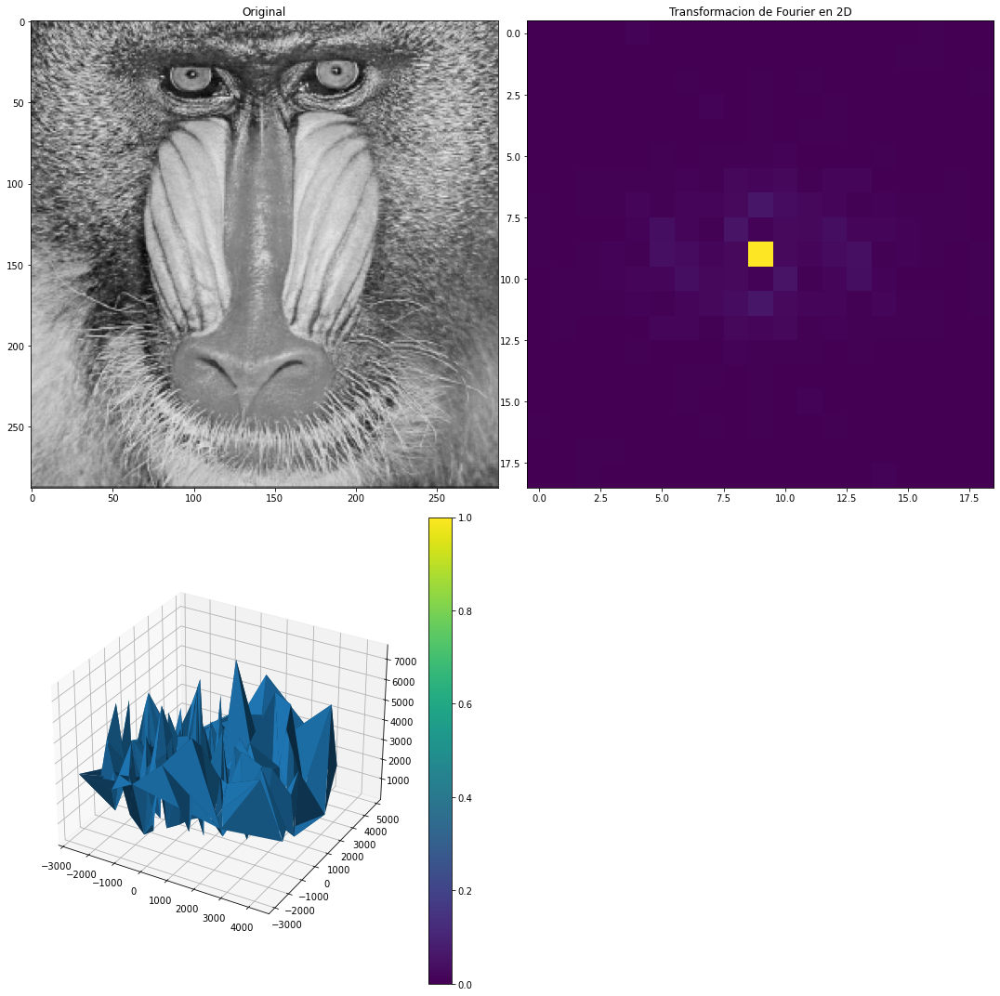

In [26]:
bthg,btc=ideal_bttrworth_hg(image_monkey, 10)
Put_3d(bthg, btc)

6. 6.5.6 Gaussian Highpass Filter . . . . . . . . . 132

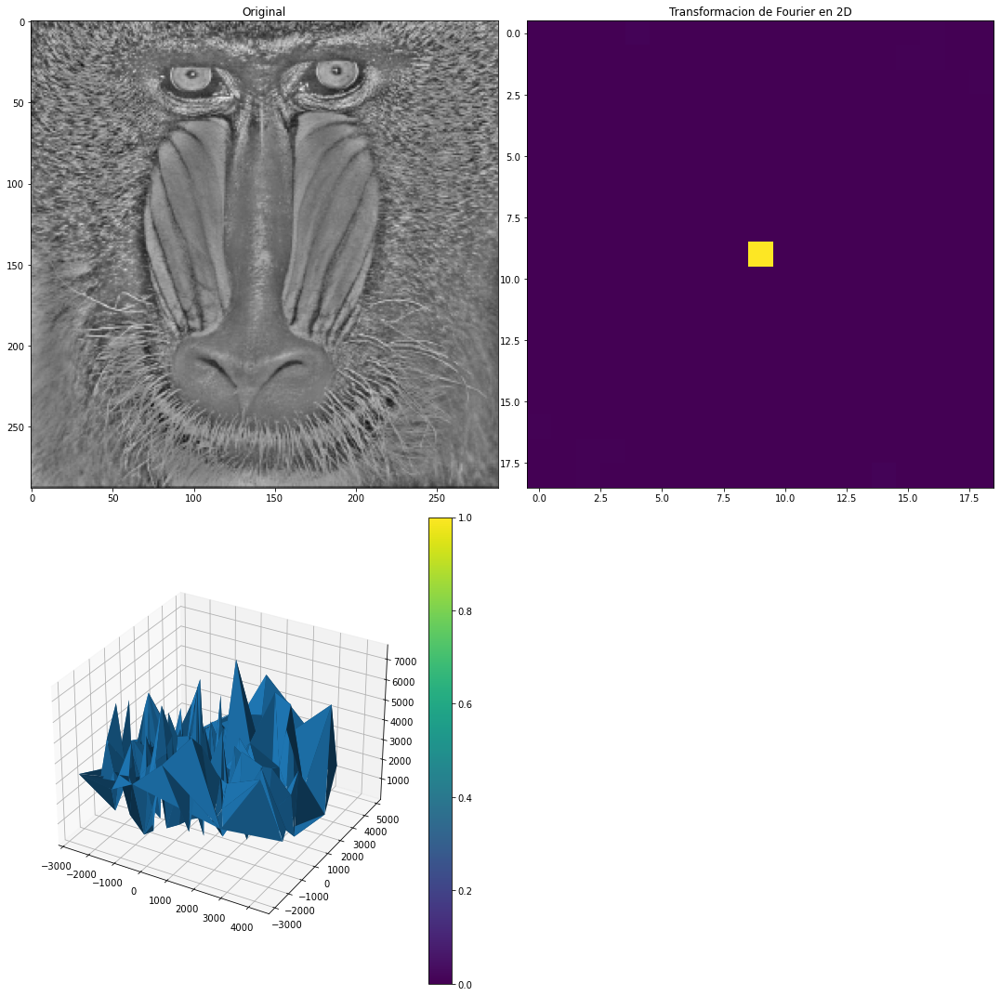

In [27]:
gh,gc=gauss_hg_filt(image_monkey,10)
Put_3d(gh, gc)

7. 6.5.7 Bandpass Filter . . . . . . . . . . . . . . . . . . 134

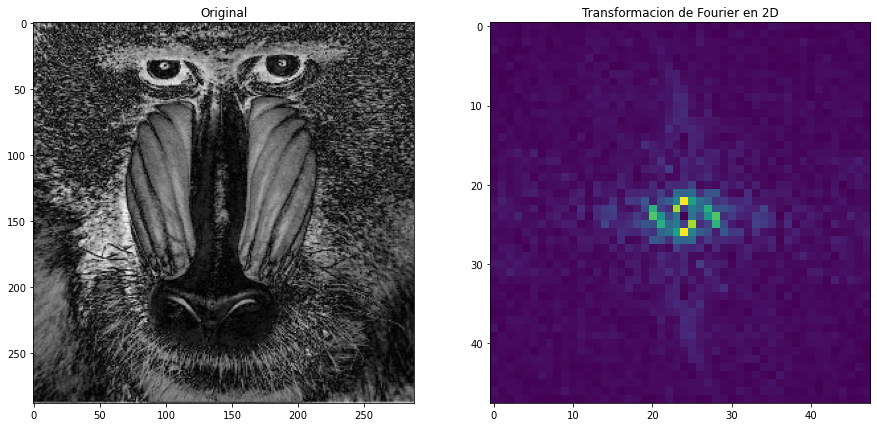

In [28]:
bd,bdc=bandass_filt(image_monkey,.1,600)
Put_only2D(bd,bdc,x=120,y=120,dx=xs-120,dy=ys-120)

8. Filtro Lapaciano en la frecuencia. . . . . . . . . 286

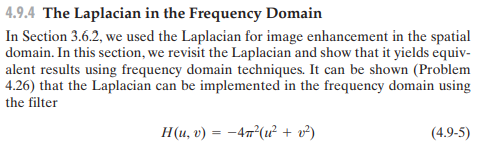
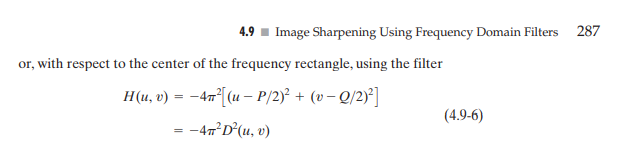

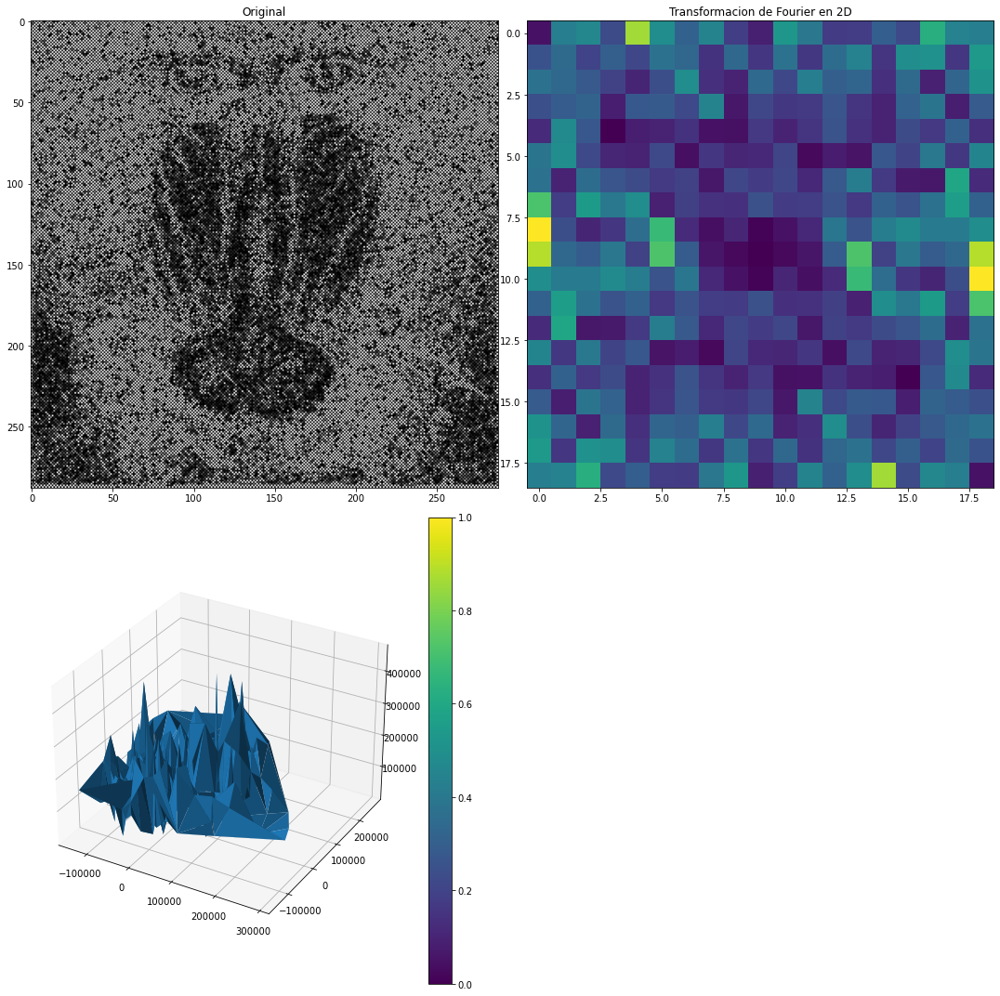

In [29]:
lp,lpc=freclaplacian_filter(image_monkey)
Put_3d(lp, lpc)

### Ejercicio 2
- Filtros Pasabajos:
1. Filtro pasabajos ideal con las siguientes frecuencias de corte 5,10,15,y 20. Asegurar que se observen el efecto de anillos. Utilizar las imágenes 1 a la 3.
    1. Fig0333(a)(test_pattern_blurring_orig).tif
    2. Fig0450(a)(woman_original).tif
    3. Fig0419(a)(text_gaps_of_1_and_2_pixels).tif
Cargamos las imagenes. 

In [30]:
Fig0333=cv2.imread("C:/Users/brusl/Pictures/Imagenes_Opencv/Fig0333(a)(test_pattern_blurring_orig).tif",0)
Fig0450=cv2.imread("C:/Users/brusl/Pictures/Imagenes_Opencv/Fig0450(a)(woman_original).tif",0)
Fig0419=cv2.imread("C:/Users/brusl/Pictures/Imagenes_Opencv/Fig0419(a)(text_gaps_of_1_and_2_pixels).tif",0)

- frecuencia de corte: 5

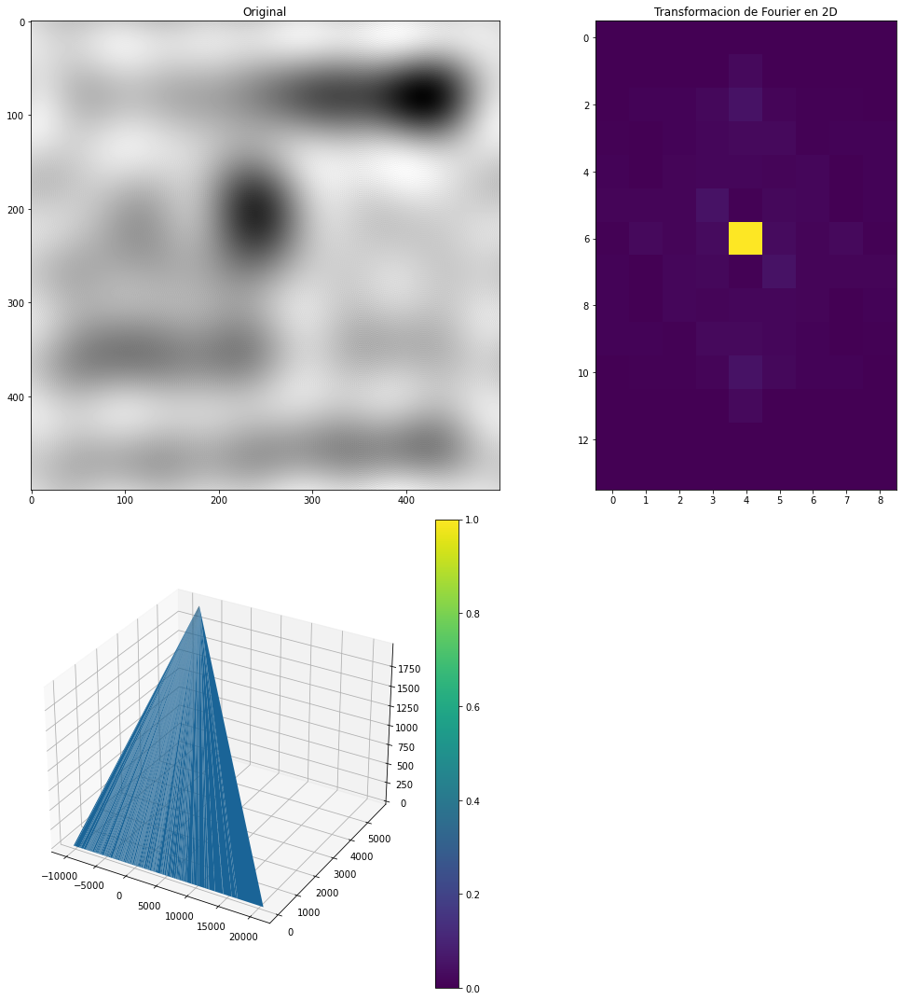

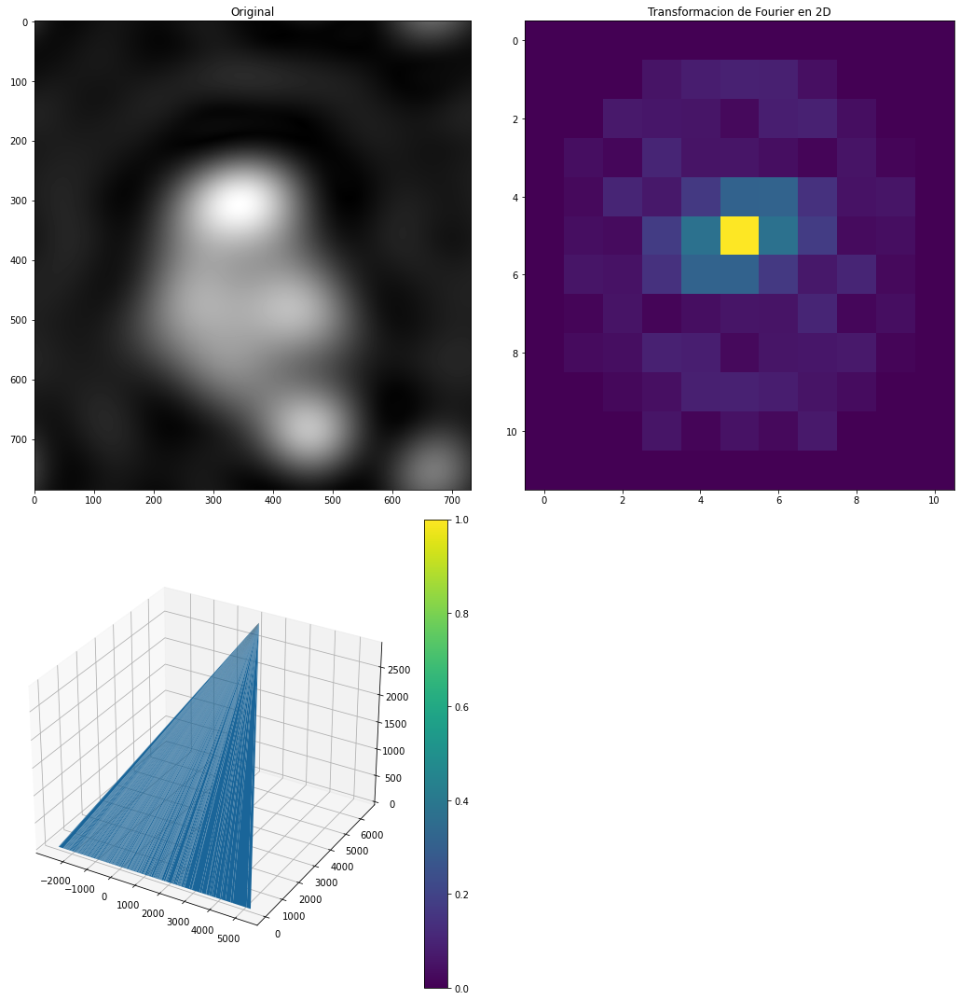

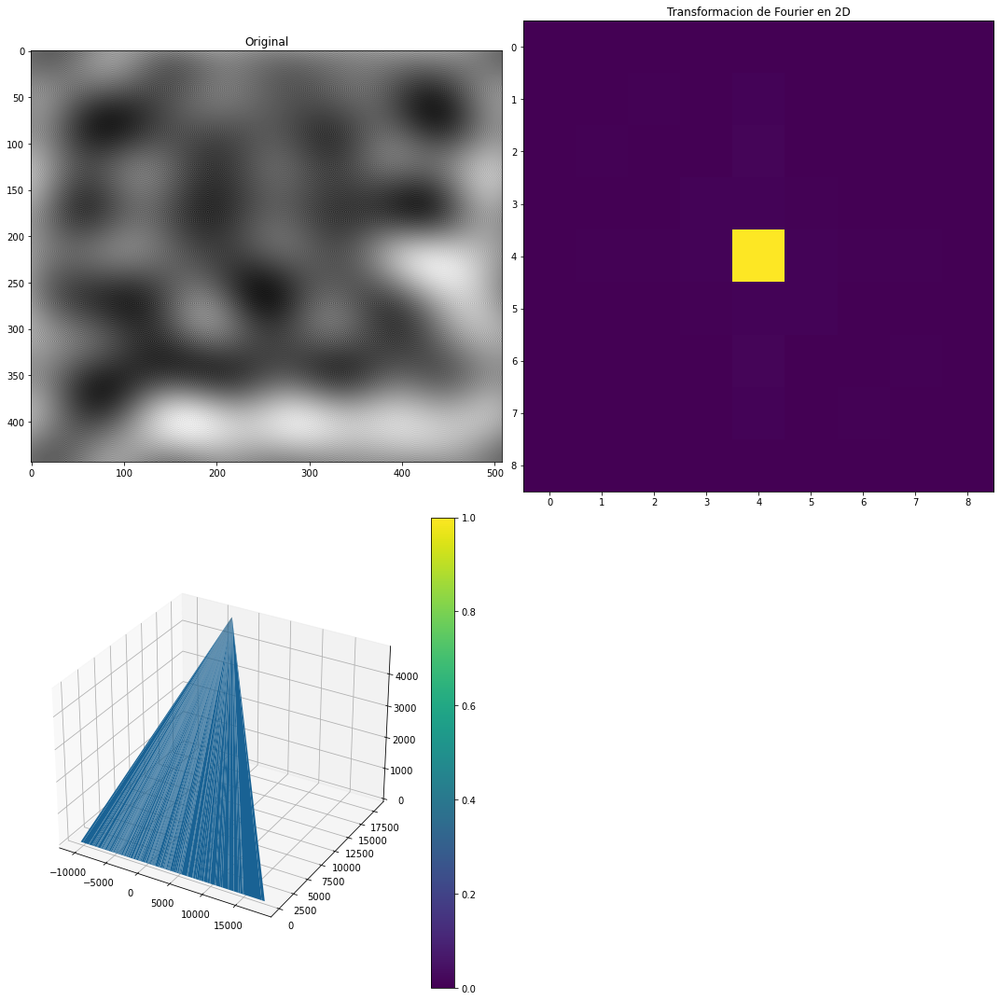

In [31]:
f03,f03c=ideal_lw_filters(Fig0333,5)
Put_3d(f03, f03c,x=244,y=246,dx=258,dy=255)
f04,f04c=ideal_lw_filters(Fig0450,5)
xs,ys=f04.shape
Put_3d(f04,f04c,x=387,y=361,dx=xs-386,dy=ys-360)
f041,f041c=ideal_lw_filters(Fig0419,5)
xs1,ys1=f041c.shape
Put_3d(f041,f041c,x=218,y=250,dx=xs1-217,dy=ys1-249)

- frecuencia de corte:10

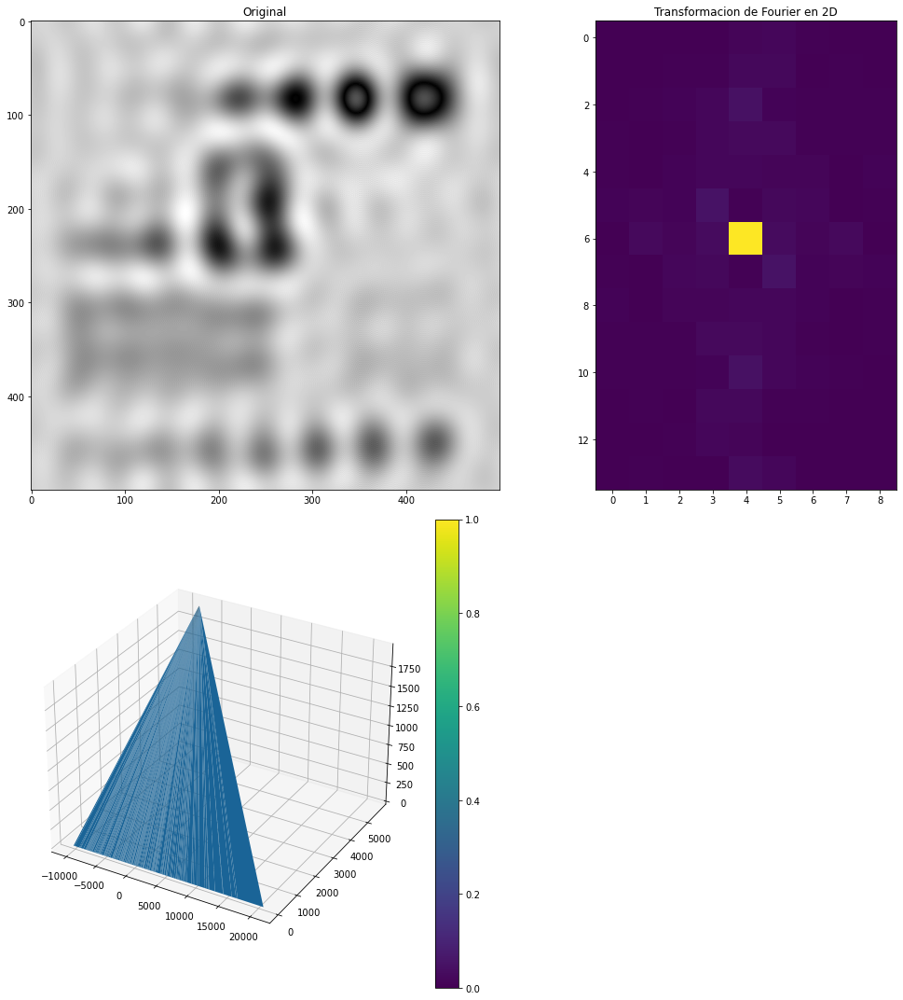

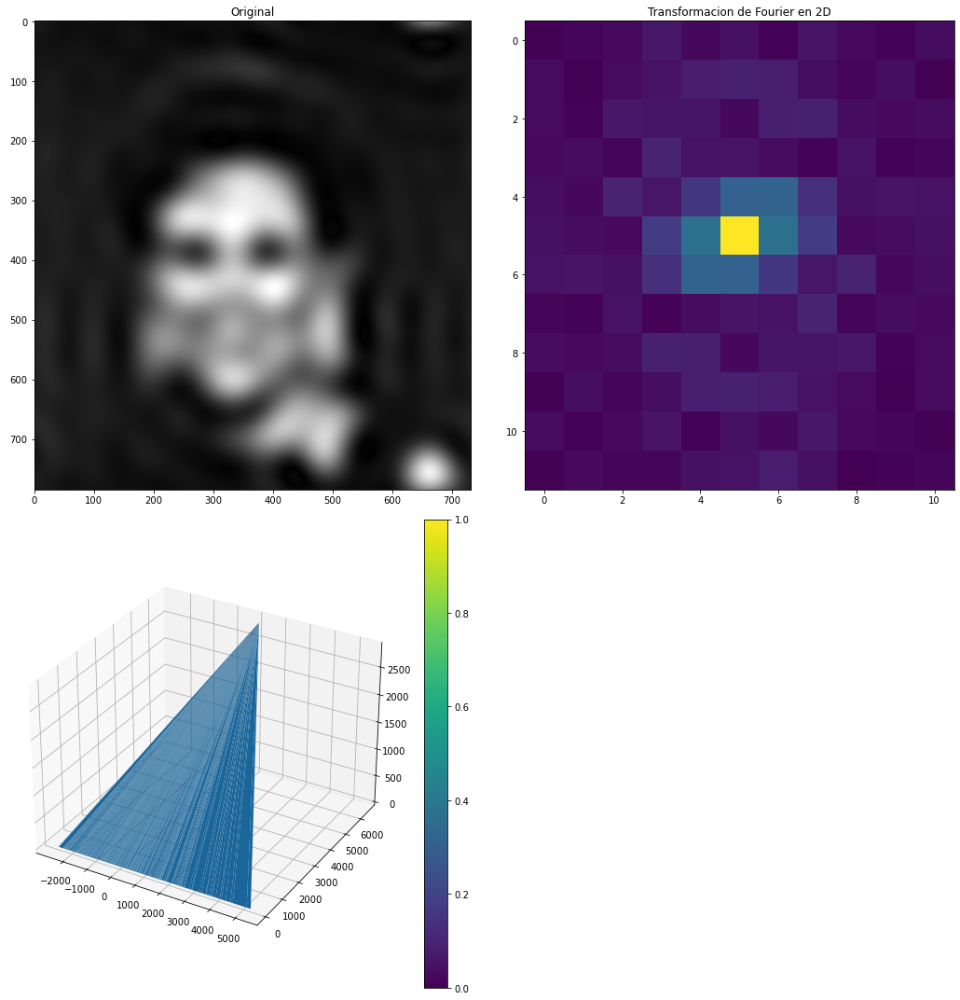

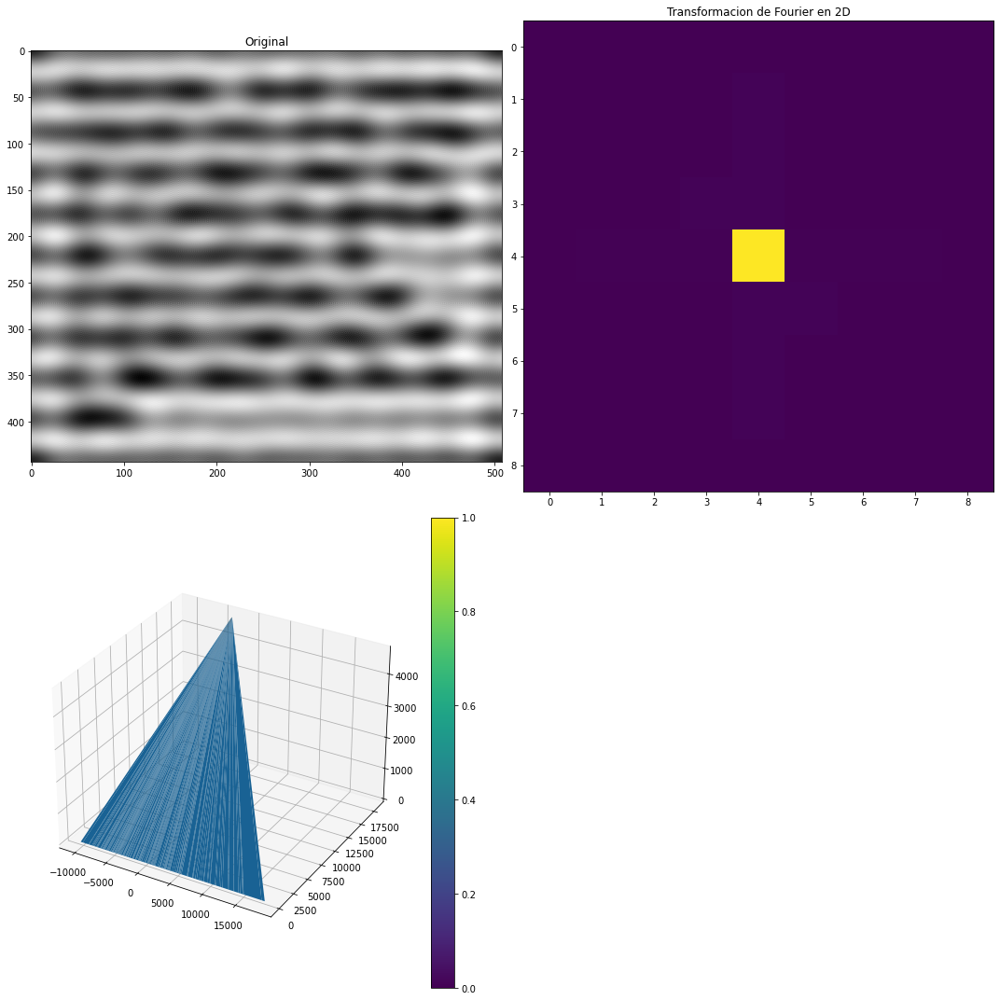

In [32]:
f03,f03c=ideal_lw_filters(Fig0333,10)
Put_3d(f03, f03c,x=244,y=246,dx=258,dy=255)
f04,f04c=ideal_lw_filters(Fig0450,10)
xs,ys=f04.shape
Put_3d(f04,f04c,x=387,y=361,dx=xs-386,dy=ys-360)
f041,f041c=ideal_lw_filters(Fig0419,10)
xs1,ys1=f041c.shape
Put_3d(f041,f041c,x=218,y=250,dx=xs1-217,dy=ys1-249)

- frecuencia de corte:15

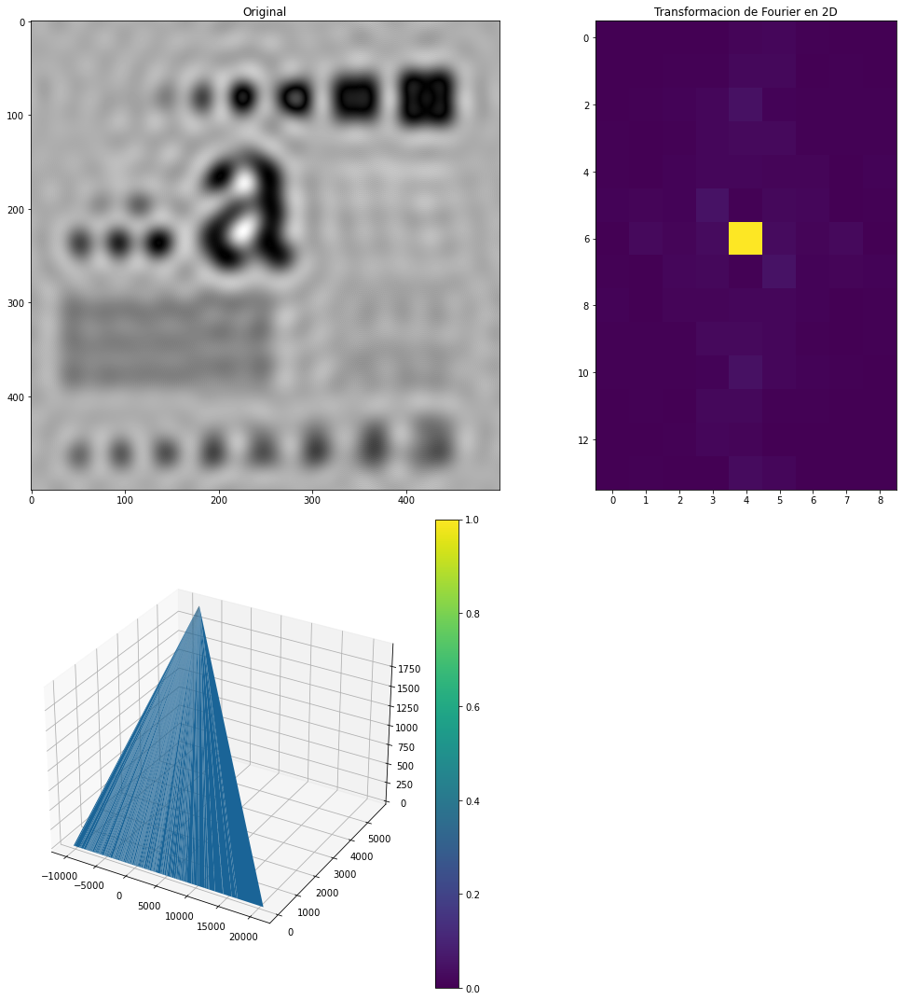

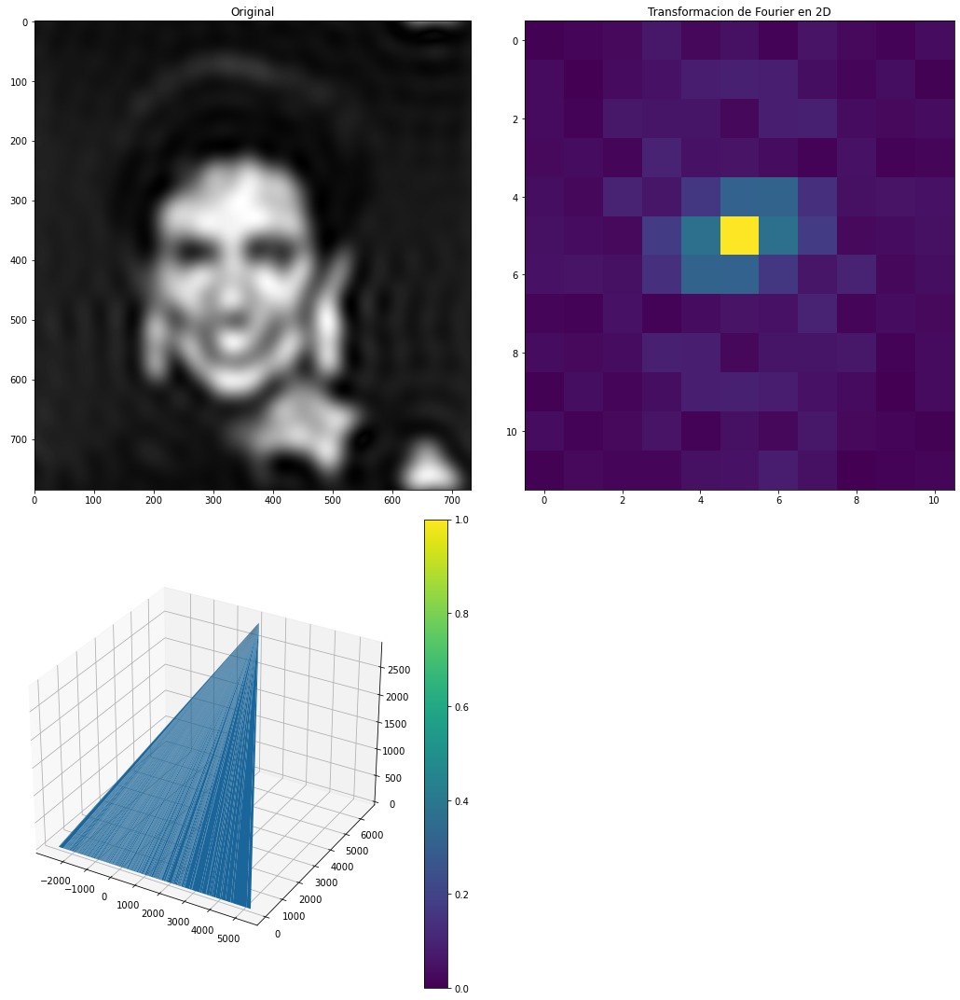

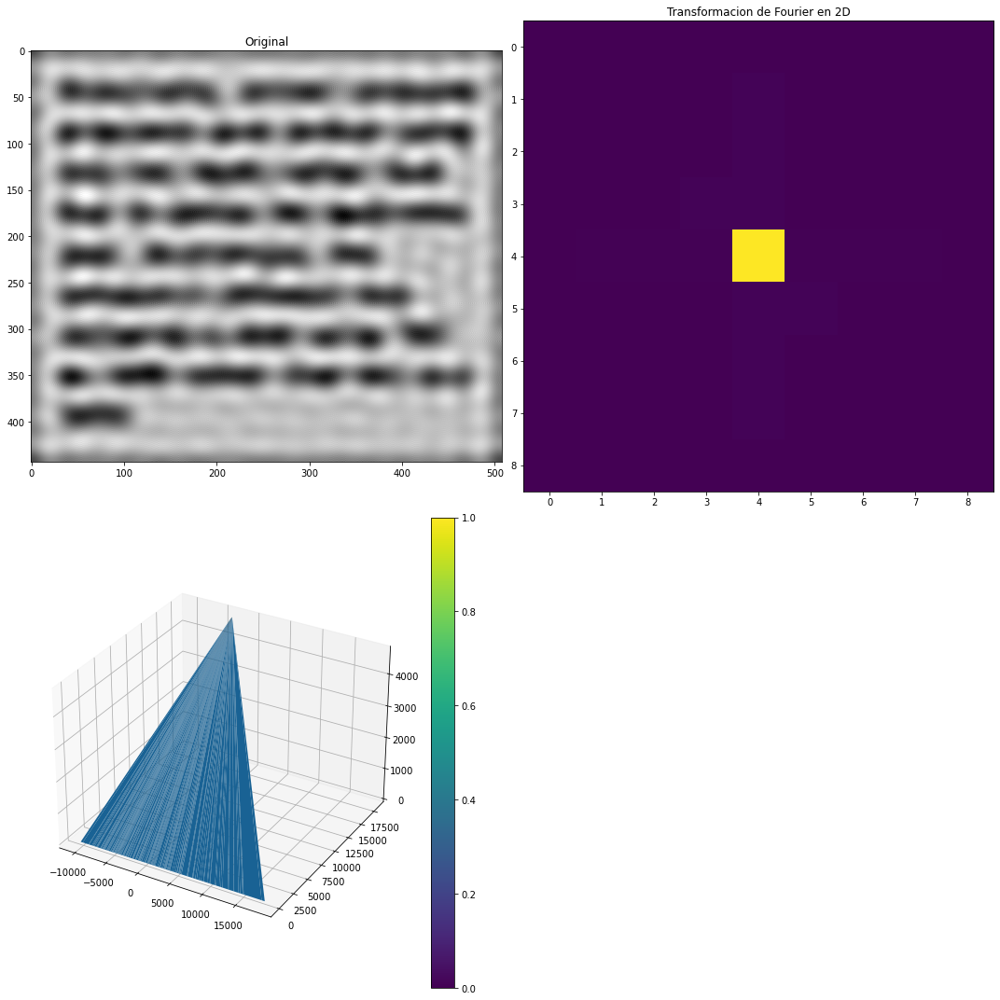

In [33]:
f03,f03c=ideal_lw_filters(Fig0333,15)
Put_3d(f03, f03c,x=244,y=246,dx=258,dy=255)
f04,f04c=ideal_lw_filters(Fig0450,15)
xs,ys=f04.shape
Put_3d(f04,f04c,x=387,y=361,dx=xs-386,dy=ys-360)
f041,f041c=ideal_lw_filters(Fig0419,15)
xs1,ys1=f041c.shape
Put_3d(f041,f041c,x=218,y=250,dx=xs1-217,dy=ys1-249)

- frecuencia de corte:20

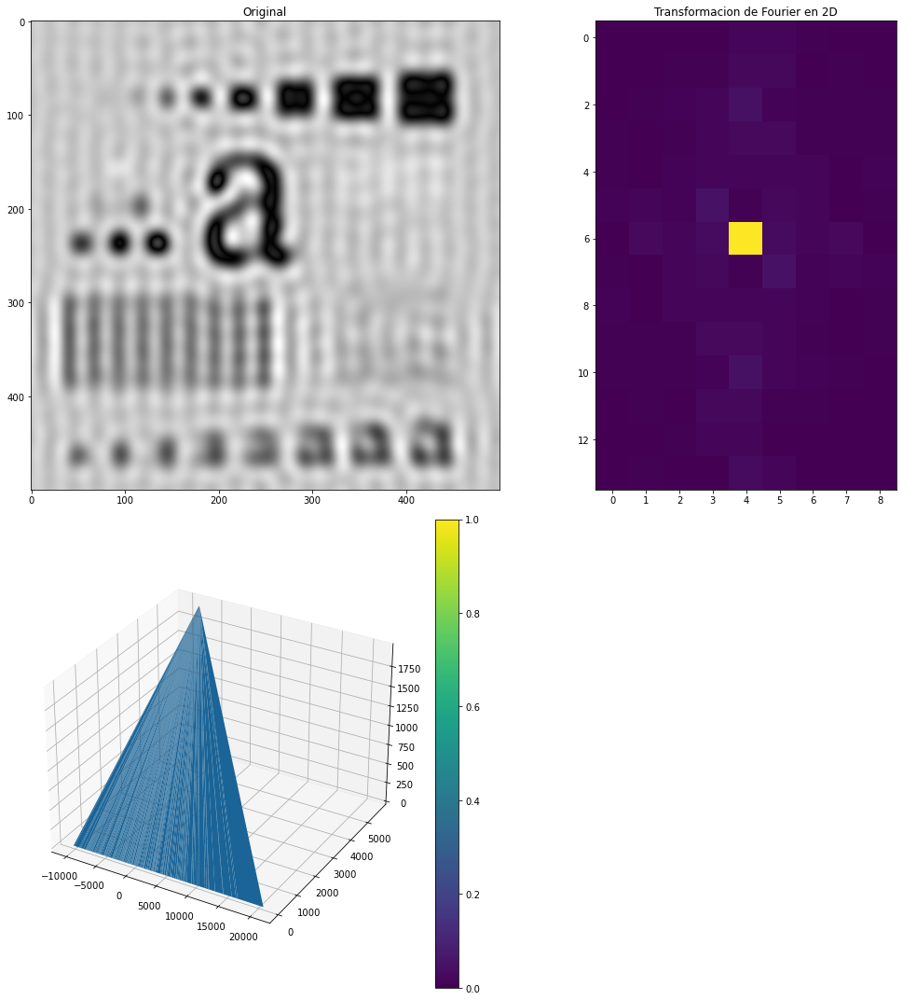

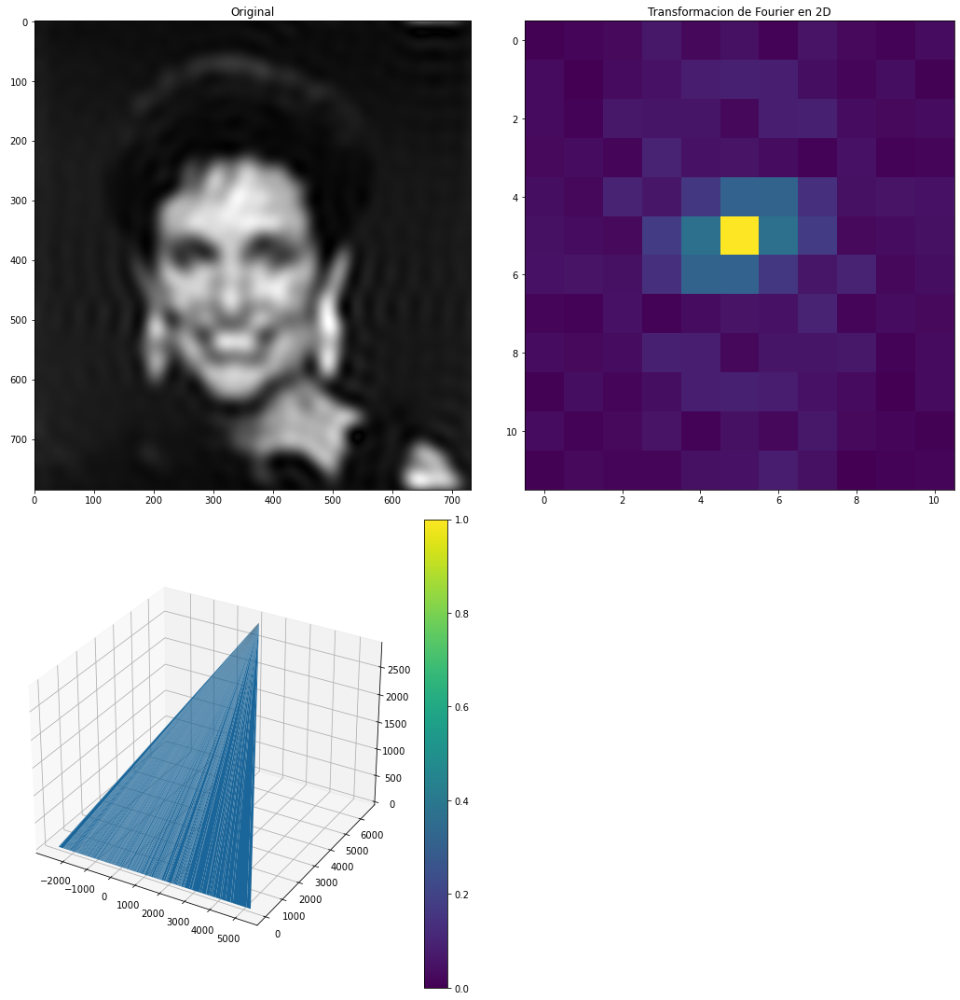

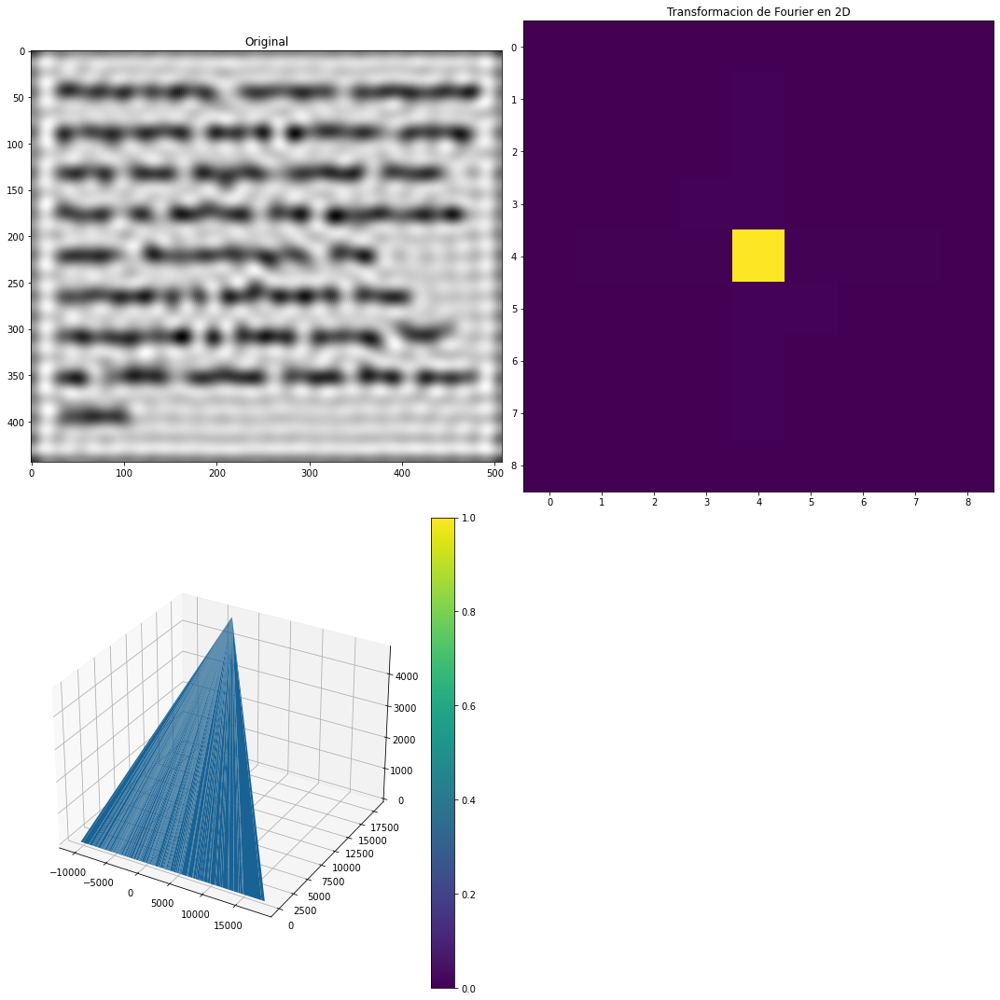

In [34]:
f03,f03c=ideal_lw_filters(Fig0333,20)
Put_3d(f03, f03c,x=244,y=246,dx=258,dy=255)
f04,f04c=ideal_lw_filters(Fig0450,20)
xs,ys=f04.shape
Put_3d(f04,f04c,x=387,y=361,dx=xs-386,dy=ys-360)
f041,f041c=ideal_lw_filters(Fig0419,20)
xs1,ys1=f041c.shape
Put_3d(f041,f041c,x=218,y=250,dx=xs1-217,dy=ys1-249)

2. Filtro pasabajos tipo Butterworth de orden 4, 3 y 2. Usted debe proponer que freccuencia de corte es la adecuada(usar al menos 4 frecuencias de corte diferentes) para cada tipo de imagen ( usar imágenes 1 a la 3 ).
    1. Fig0333(a)(test_pattern_blurring_orig).tif
    2. Fig0450(a)(woman_original).tif
    3. Fig0419(a)(text_gaps_of_1_and_2_pixels).tif
- 10

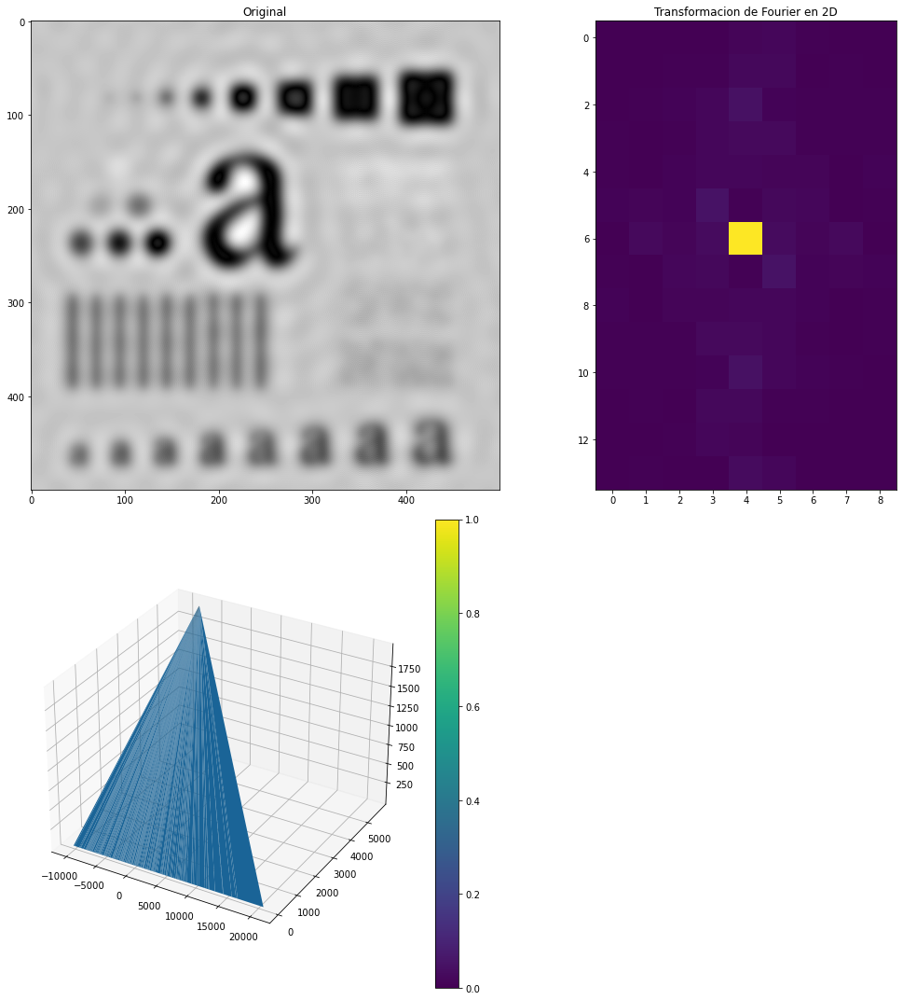

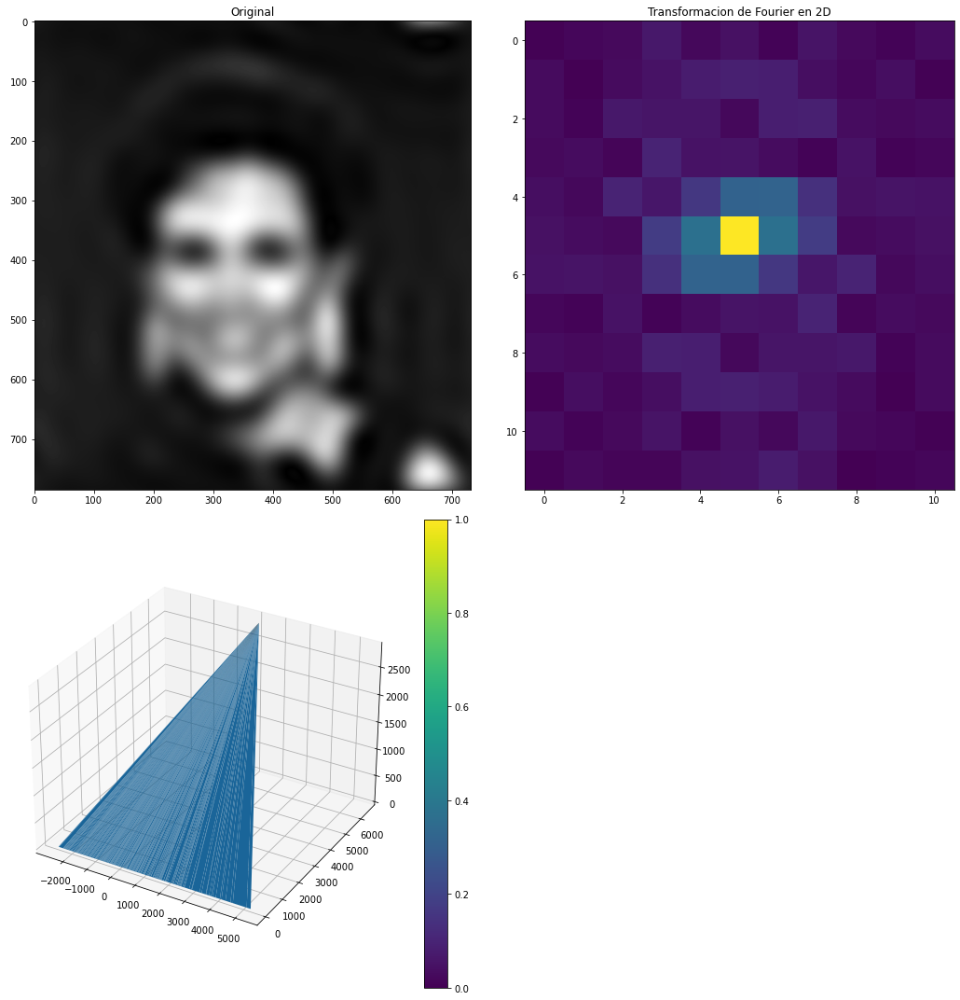

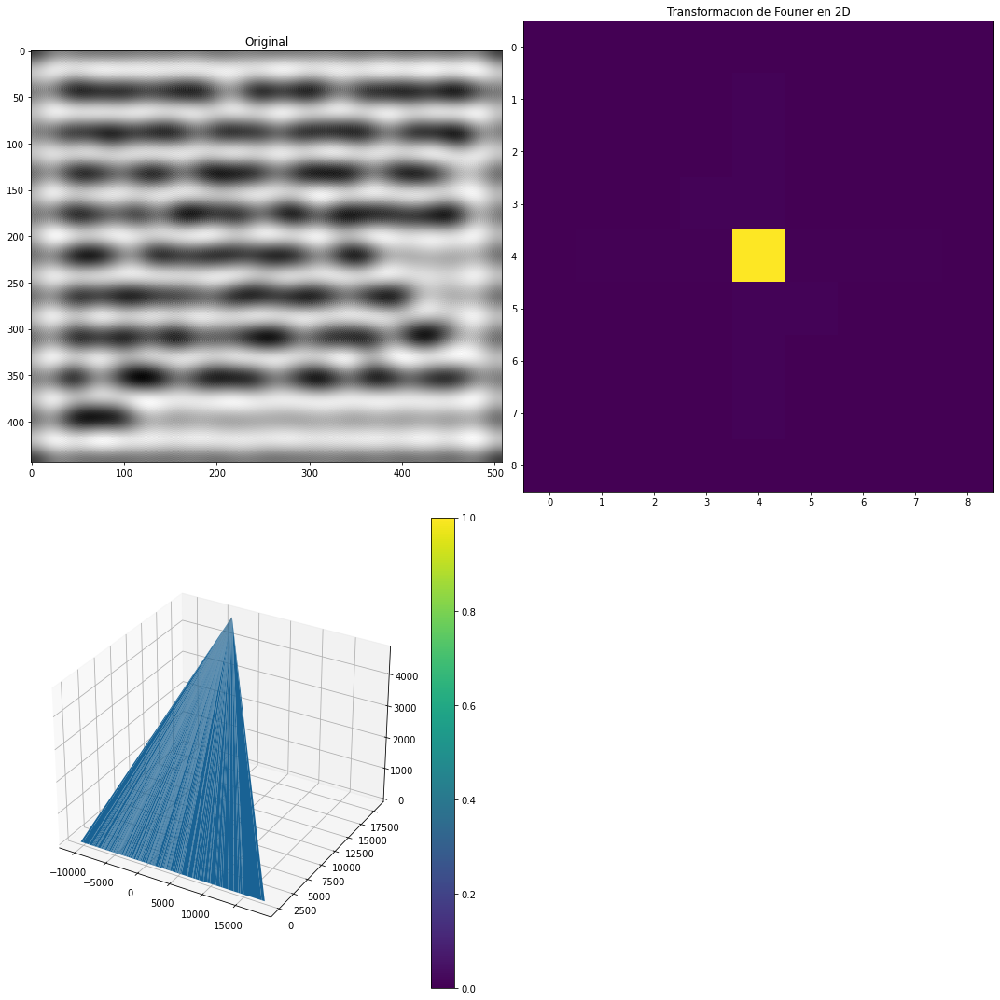

In [35]:
f03,f03c=ideal_butterworth(Fig0333,15,2)
Put_3d(f03, f03c,x=244,y=246,dx=258,dy=255)
f04,f04c=ideal_butterworth(Fig0450,10,3)
xs,ys=f04.shape
Put_3d(f04,f04c,x=387,y=361,dx=xs-386,dy=ys-360)
f041,f041c=ideal_butterworth(Fig0419,10,4)
xs1,ys1=f041c.shape
Put_3d(f041,f041c,x=218,y=250,dx=xs1-217,dy=ys1-249)

- 15

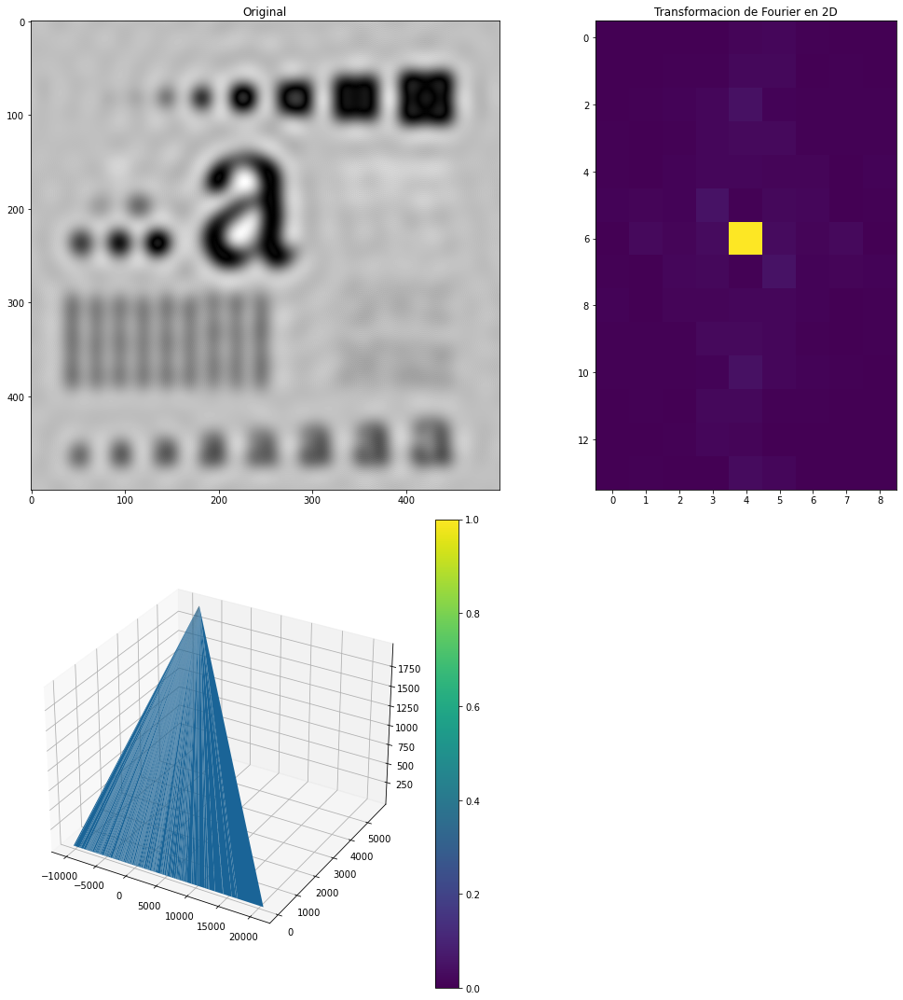

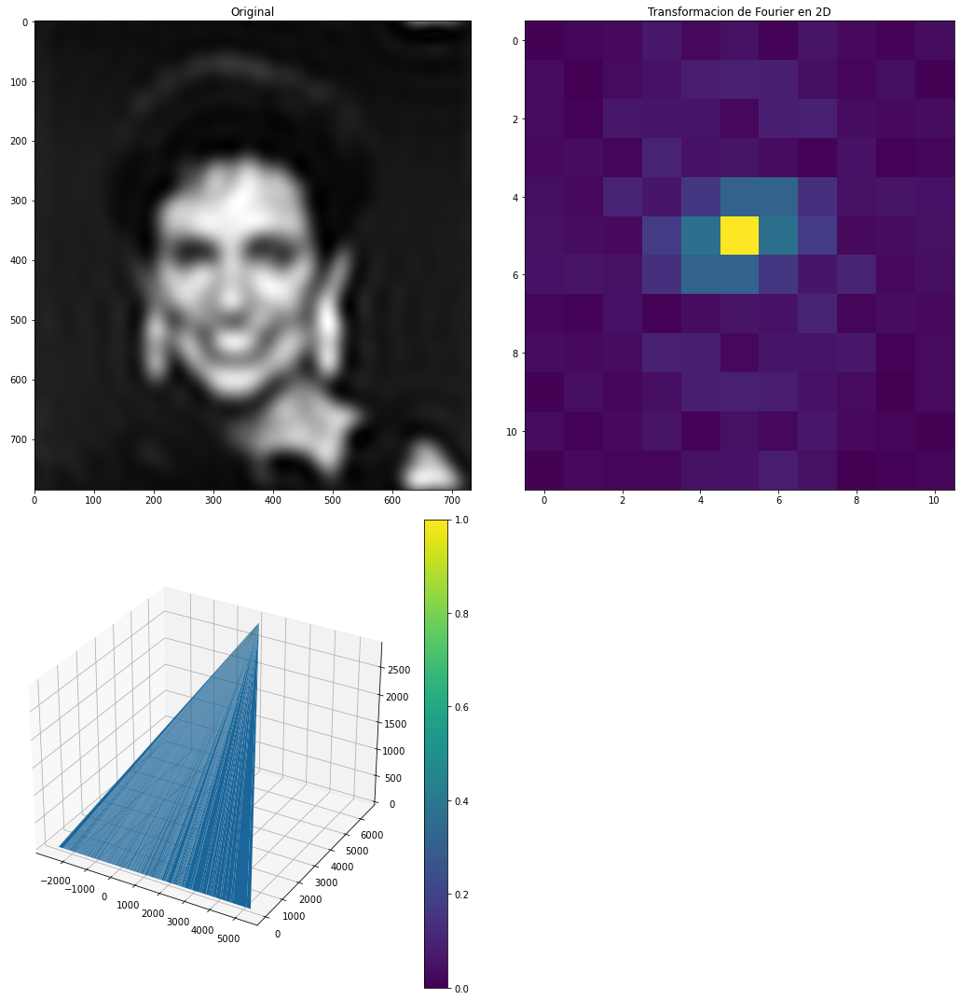

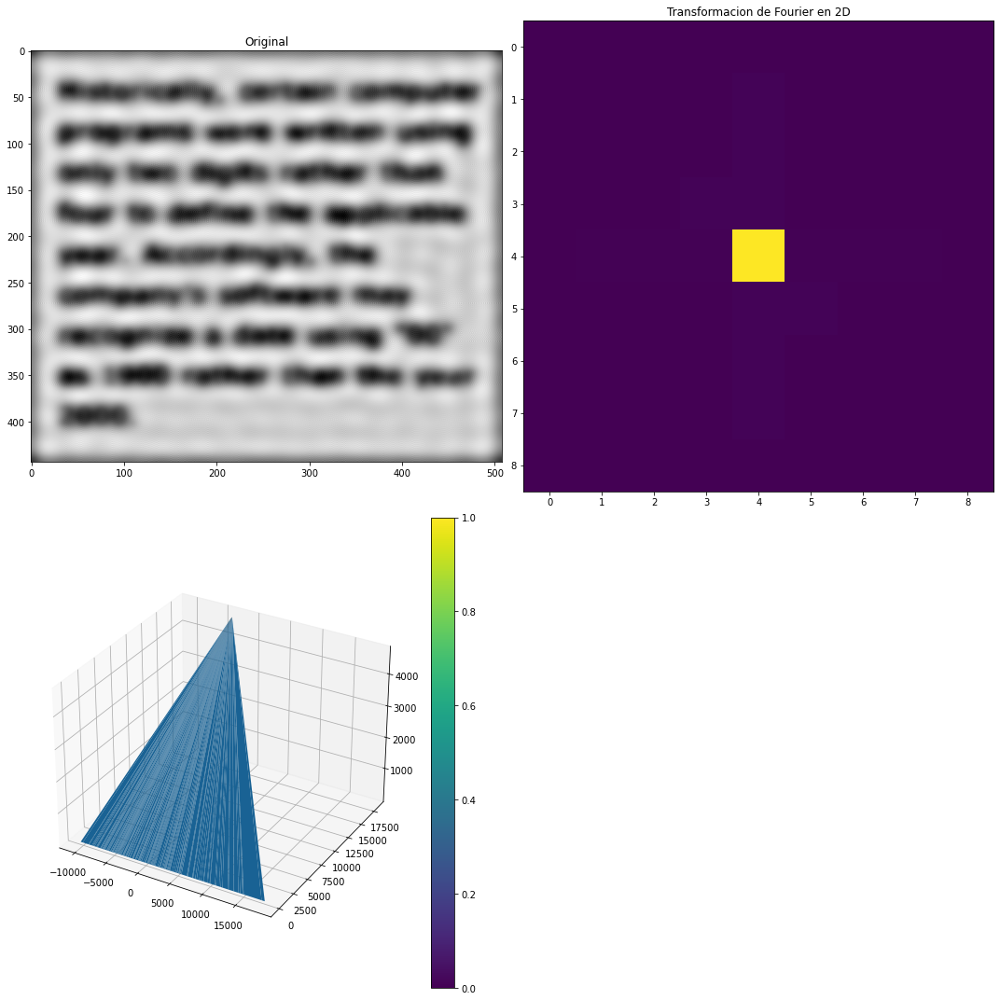

In [36]:
f03,f03c=ideal_butterworth(Fig0333,15,3)
Put_3d(f03, f03c,x=244,y=246,dx=258,dy=255)
f04,f04c=ideal_butterworth(Fig0450,15,4)
xs,ys=f04.shape
Put_3d(f04,f04c,x=387,y=361,dx=xs-386,dy=ys-360)
f041,f041c=ideal_butterworth(Fig0419,15,2)
xs1,ys1=f041c.shape
Put_3d(f041,f041c,x=218,y=250,dx=xs1-217,dy=ys1-249)

- 20

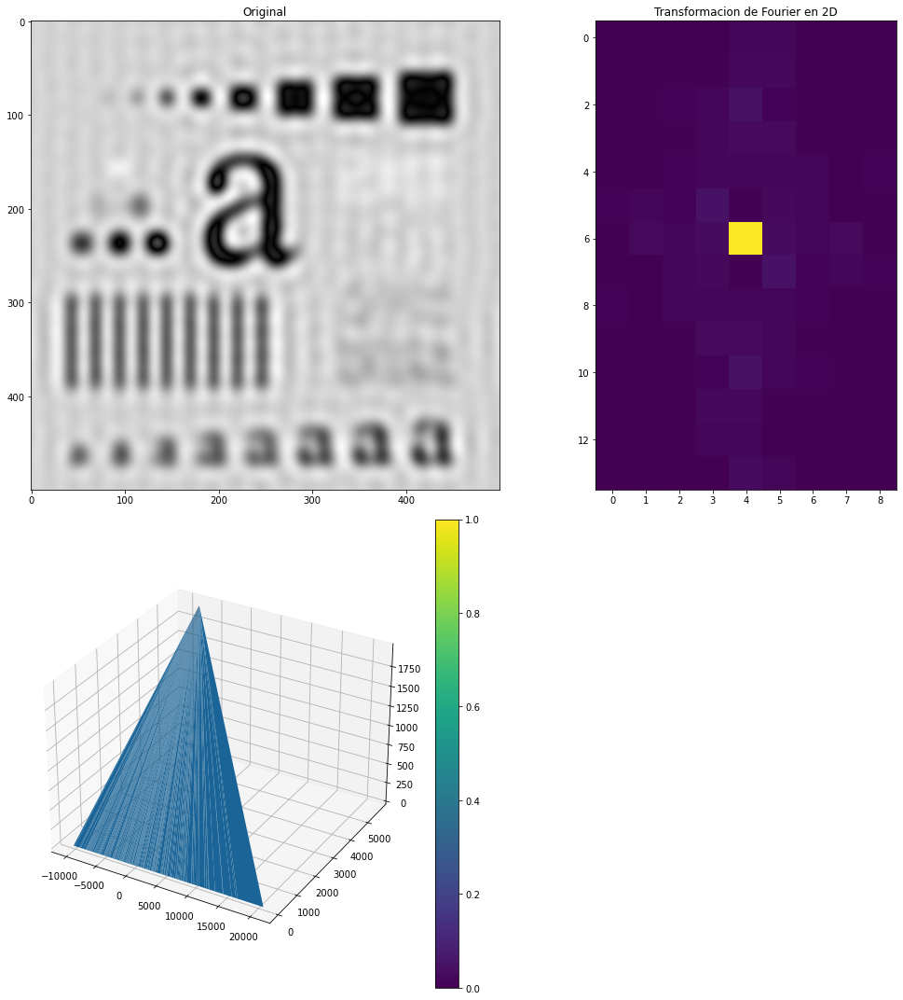

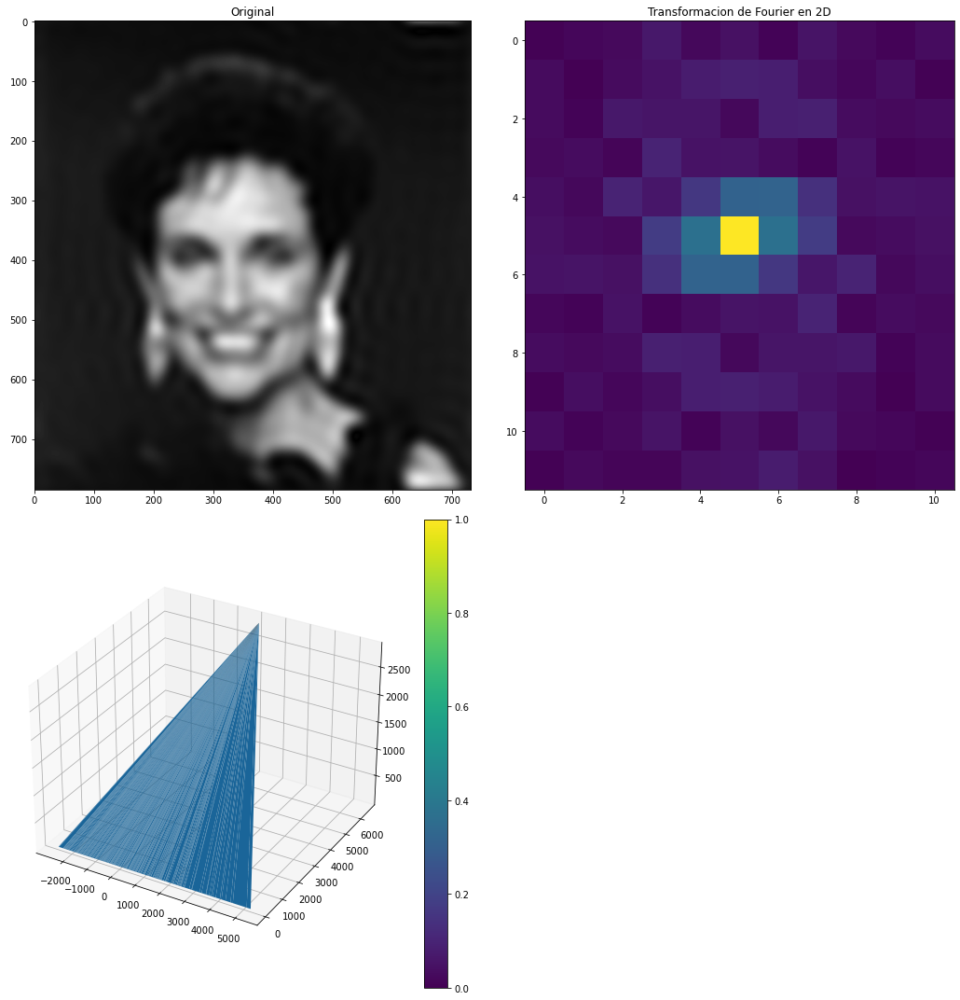

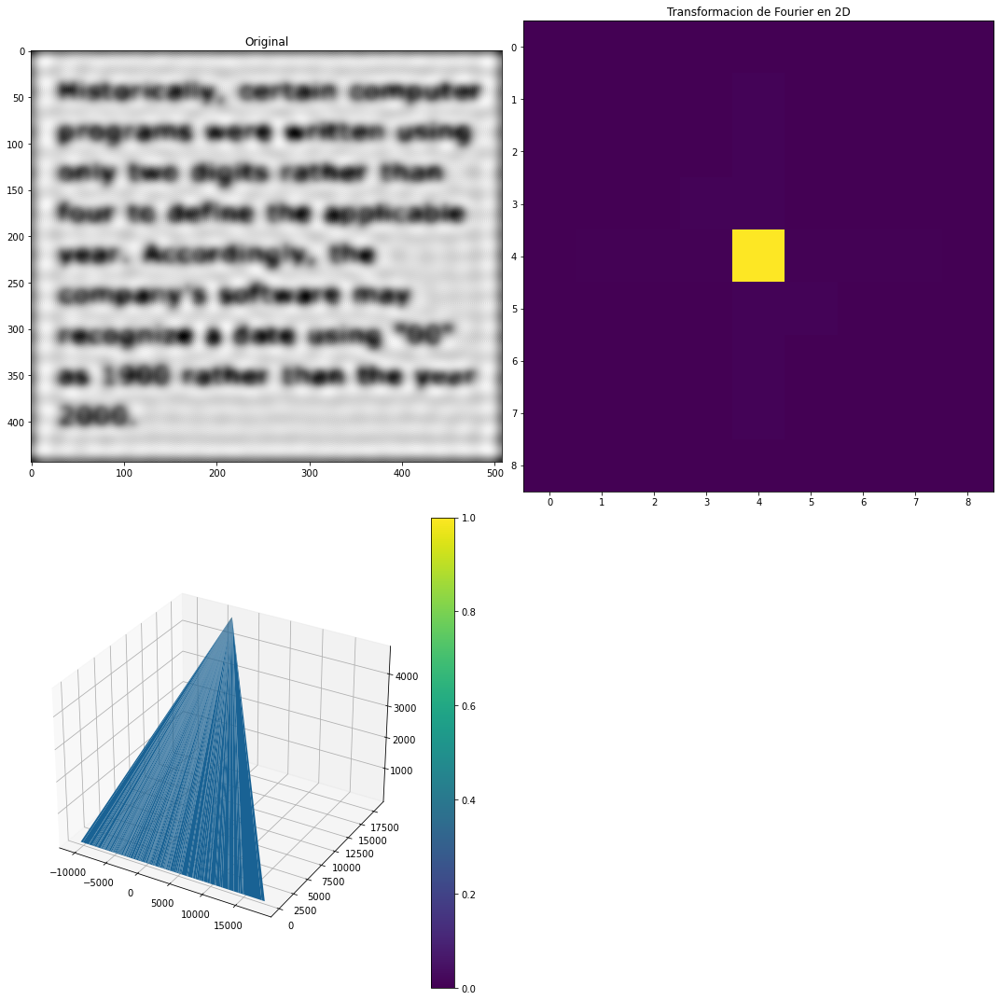

In [37]:
f03,f03c=ideal_butterworth(Fig0333,20,4)
Put_3d(f03, f03c,x=244,y=246,dx=258,dy=255)
f04,f04c=ideal_butterworth(Fig0450,20,3)
xs,ys=f04.shape
Put_3d(f04,f04c,x=387,y=361,dx=xs-386,dy=ys-360)
f041,f041c=ideal_butterworth(Fig0419,20,2)
xs1,ys1=f041c.shape
Put_3d(f041,f041c,x=218,y=250,dx=xs1-217,dy=ys1-249)

- 55 

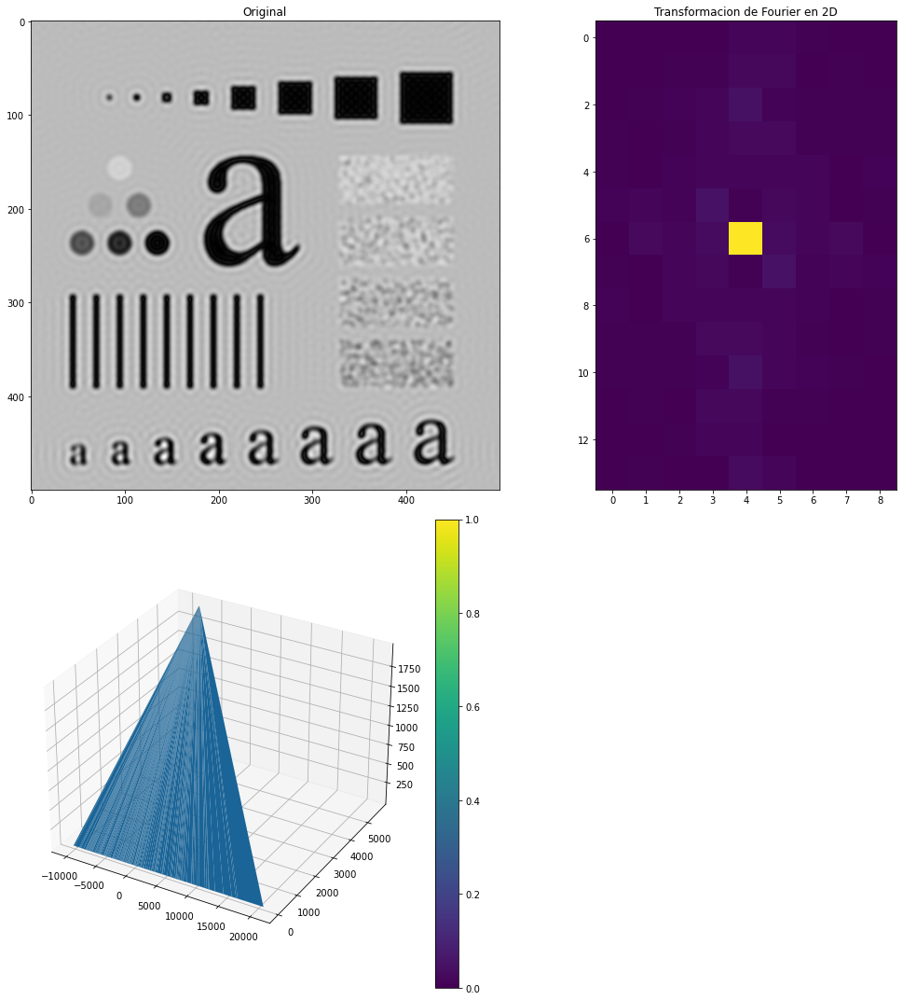

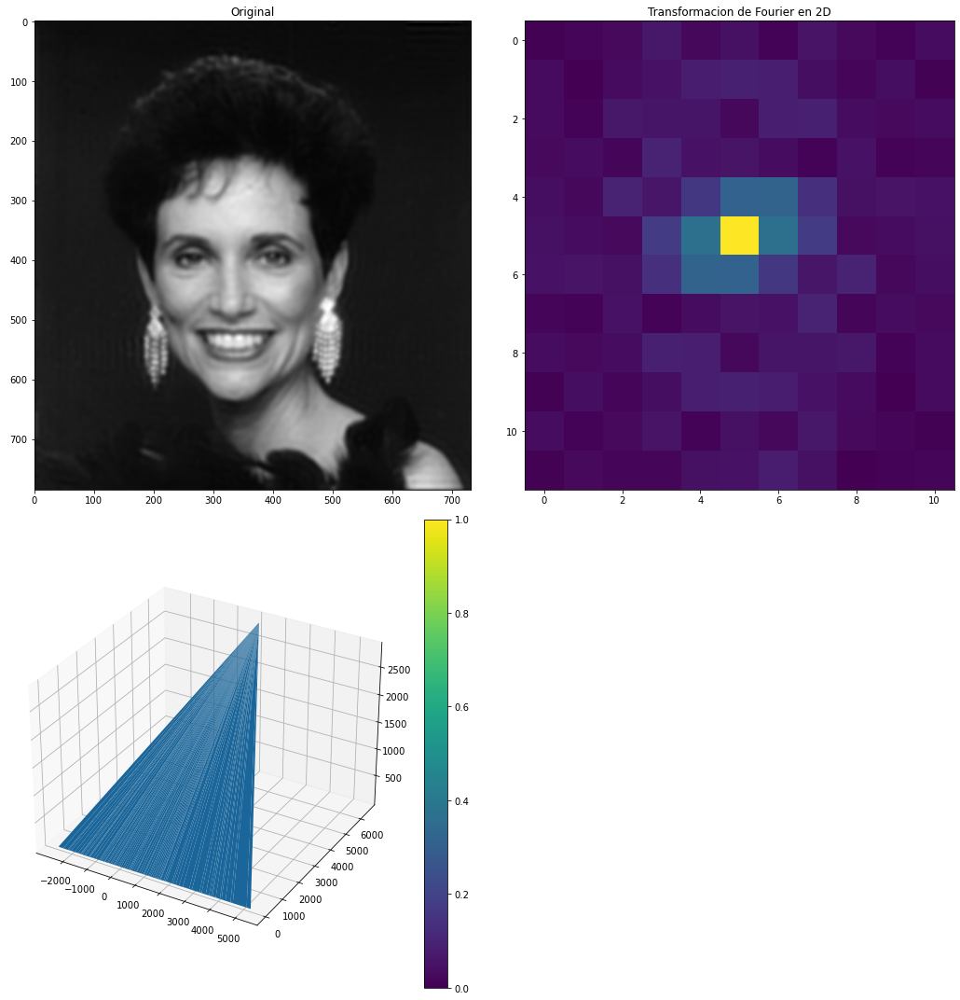

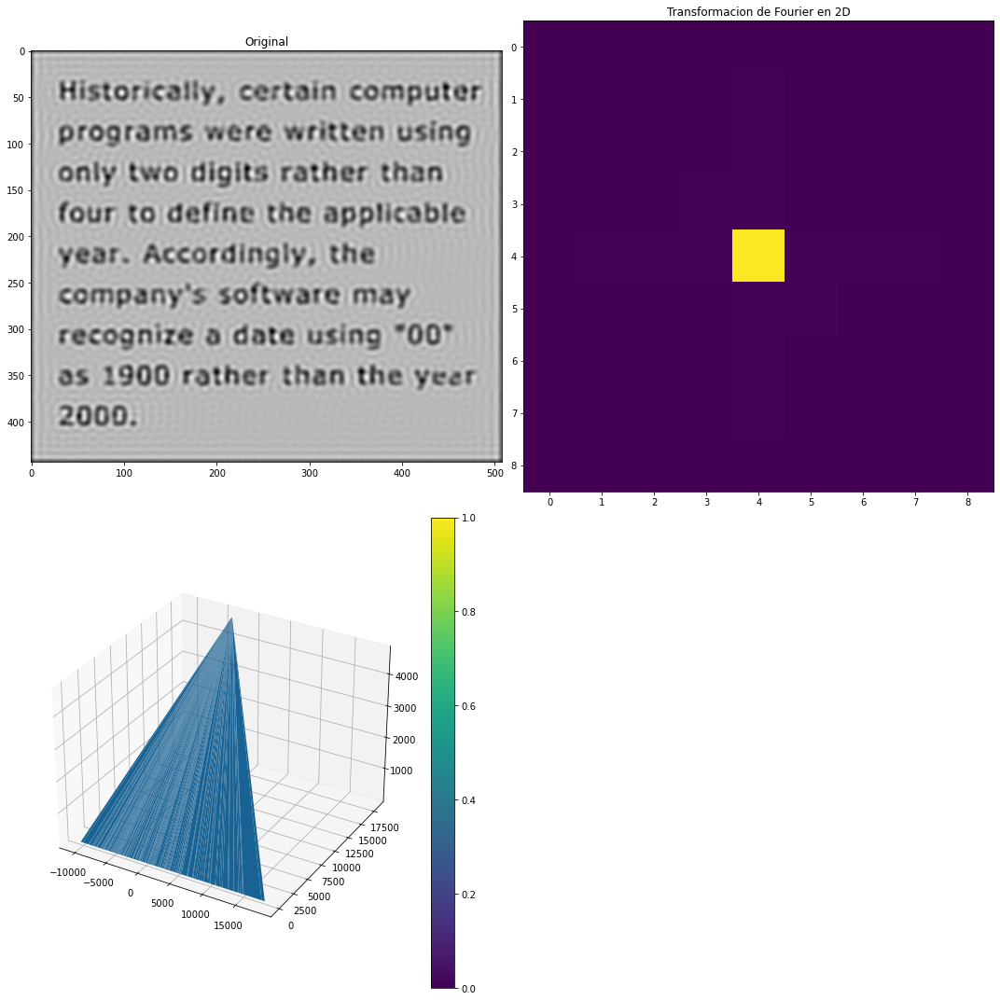

In [38]:
f03,f03c=ideal_butterworth(Fig0333,55,3)
Put_3d(f03, f03c,x=244,y=246,dx=258,dy=255)
f04,f04c=ideal_butterworth(Fig0450,55,2)
xs,ys=f04.shape
Put_3d(f04,f04c,x=387,y=361,dx=xs-386,dy=ys-360)
f041,f041c=ideal_butterworth(Fig0419,55,4)
xs1,ys1=f041c.shape
Put_3d(f041,f041c,x=218,y=250,dx=xs1-217,dy=ys1-249)

3. Para este ejemplo se debe extraer una región de la imagen según se indica en el texto: 1-Adrian_Rosebrock_Practical_Python_and_OpenCV.pdf, posteriomente se debe usar un filtro pasabajos Gaussiano y repetir el ejemplo de la figura 4.50(pág. 280 libro de texto 3era edición) usando la imagen 2.
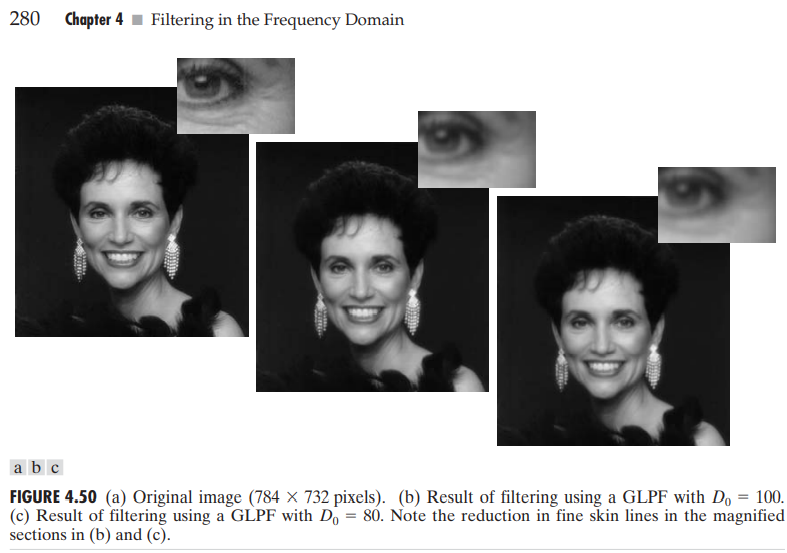
- d_0=100

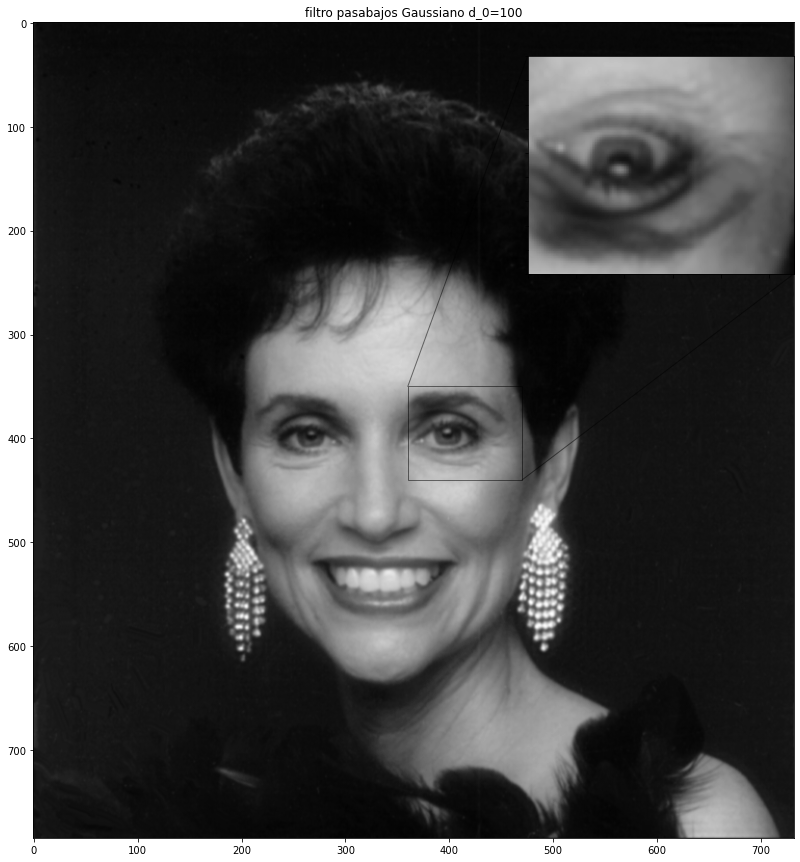

In [39]:
F0450,d=gauss_lw_filt(Fig0450,100)
fig,ax= plt.subplots(figsize=(15, 15));rows,columns = 1,1# crear figura, establecer los valores del tamaño de los subplots
ax.imshow(F0450,cmap="gray"),plt.title("filtro pasabajos Gaussiano d_0=100")
axins = ax.inset_axes([0.65, 0.65, 0.35, 0.35])
x1, x2, y1, y2 = 360,470 , 350, 440
axins.set_ylim(y1, y2)
axins.set_xlim(x1, x2)
axins.set_xticklabels('')
axins.set_yticklabels('')
axins.imshow(F0450,cmap="gray",origin="lower")
ax.indicate_inset_zoom(axins, edgecolor="black")
plt.show()

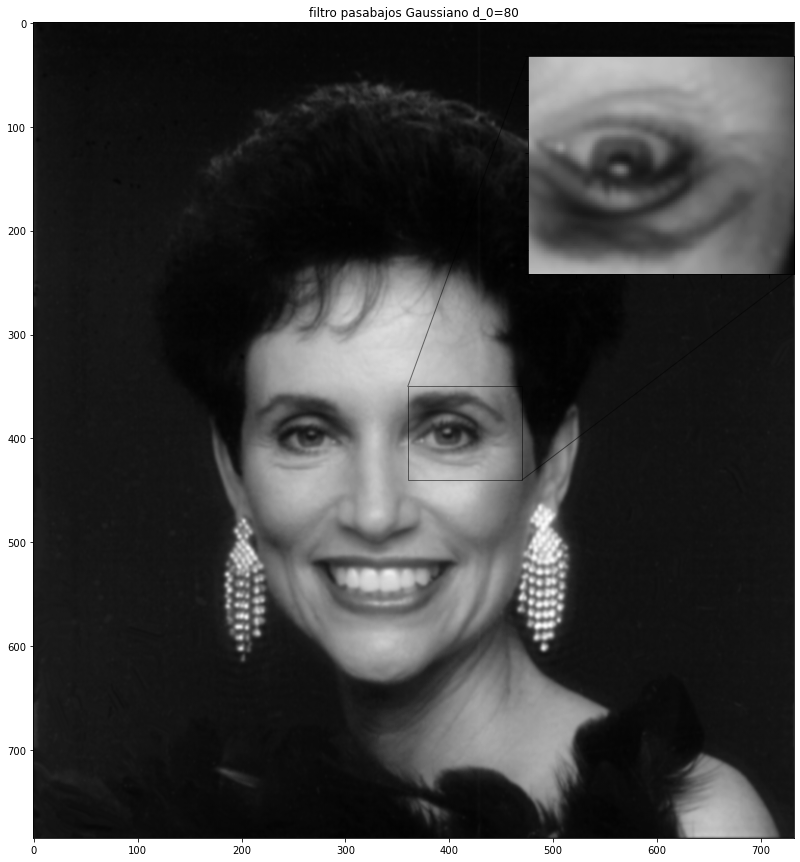

In [40]:
F0450,d=gauss_lw_filt(Fig0450,80)
fig,ax= plt.subplots(figsize=(15, 15));rows,columns = 1,1# crear figura, establecer los valores del tamaño de los subplots
ax.imshow(F0450,cmap="gray"),plt.title("filtro pasabajos Gaussiano d_0=80")
axins = ax.inset_axes([0.65, 0.65, 0.35, 0.35])
x1, x2, y1, y2 = 360,470 , 350, 440
axins.set_ylim(y1, y2)
axins.set_xlim(x1, x2)
axins.set_xticklabels('')
axins.set_yticklabels('')
axins.imshow(F0450,cmap="gray",origin="lower")
ax.indicate_inset_zoom(axins, edgecolor="black")
plt.show()

4. Filtro pasabajos Gaussiano: Repetir el ejemplo de la figura 4.51(pág. 281 libro de texto 3era edición) usando la imagen 6
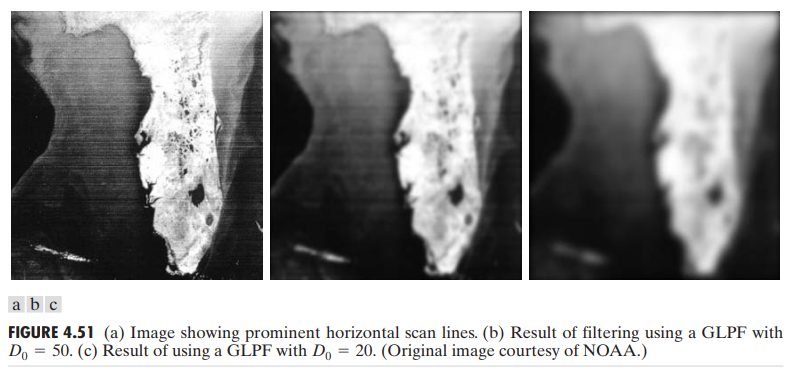

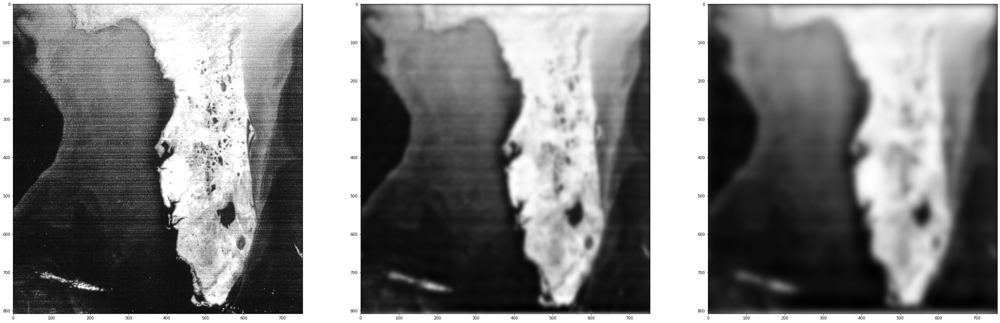

In [41]:
Fig0451=cv2.imread("C:/Users/brusl/Pictures/Imagenes_Opencv/Fig0451(a)(satellite_original).tif",0)
F0451,g0451=gauss_lw_filt(Fig0451,20)
F0451a,g0451a=gauss_lw_filt(Fig0451,10)
sub2print(Fig0451,F0451,F0451a)

### Ejercicio 3
Filtros Pasa altos: En los siguientes ejemplos Usted tendrá la oportunidad de emplear técnicas ya utilizadas previamente.
1. Repetir el ejemplo de la figura 4.54 (pag. 283 libro de texto 3era edición) Usar la imagen 1,4 y 5.
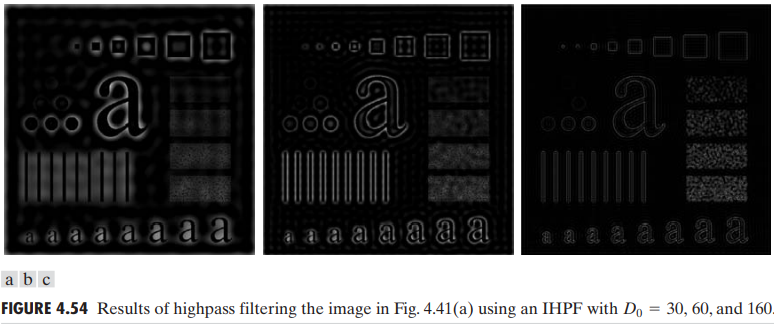

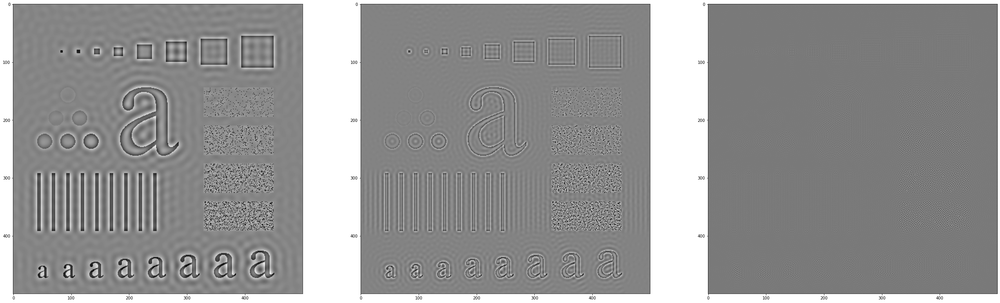

In [42]:
negativ=cv2.imread("C:/Users/brusl/Pictures/Imagenes_Opencv/negative_Fig0333(a)(test_pattern_blurring_orig).tif",0)
EF1,ef0=ideal_hgh_filt(Fig0333,30)
EF,ef0=ideal_hgh_filt(Fig0333,60)
EF2,ef0=ideal_hgh_filt(Fig0333,160)
sub2print(EF1,EF,EF2)

2. Repetir el ejemplo de la figura 4.55 (pag. 284 libro de texto 3era edición) Usar la imagen 1,4 y 5.
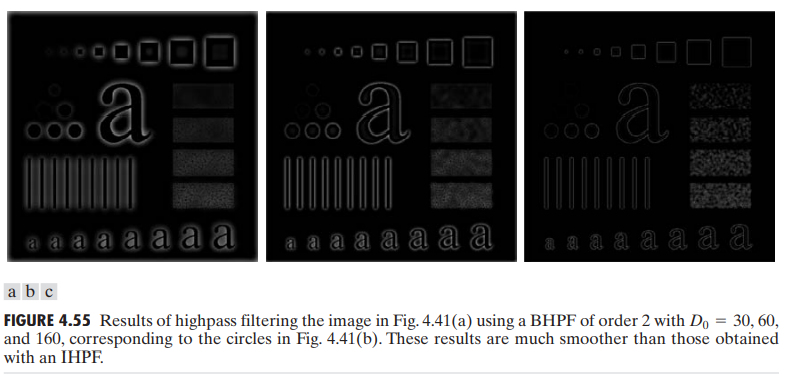

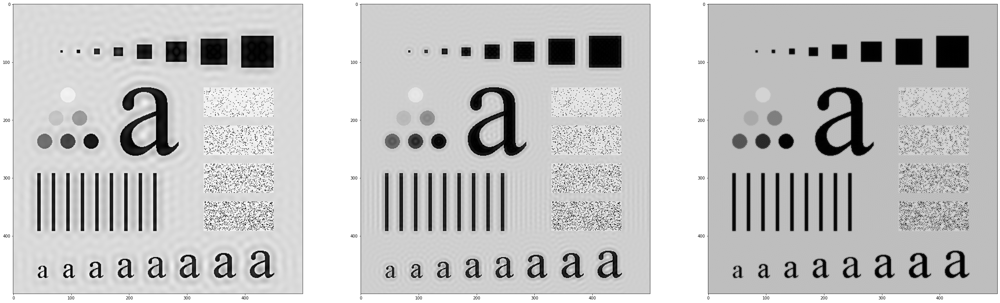

In [43]:
EF1,ef0=ideal_bttrworth_hg(Fig0333,30,2)
EF,ef0=ideal_bttrworth_hg(Fig0333,60,2)
EF2,ef0=ideal_bttrworth_hg(Fig0333,160,2)
sub2print(EF1,EF,EF2)

3. Al usar la imagen de la huella dactilar 5 , esta debe ser mejorada antes de ser filtrada.
4. Repetir el ejemplo de la figura 4.57 (pág. 286.libro de texto 3era edición) usando las imágenes 4 y 5. Para lograr el ejemplo c) debe realizar antes la elección del valor umbral y obtener un resultado similar 
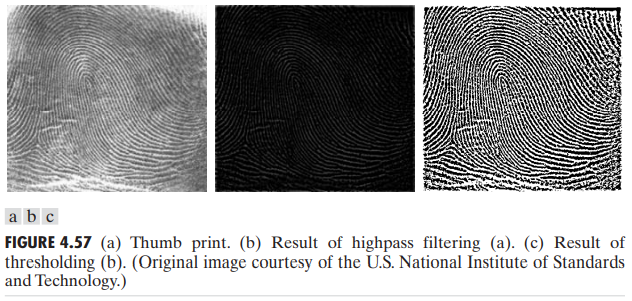

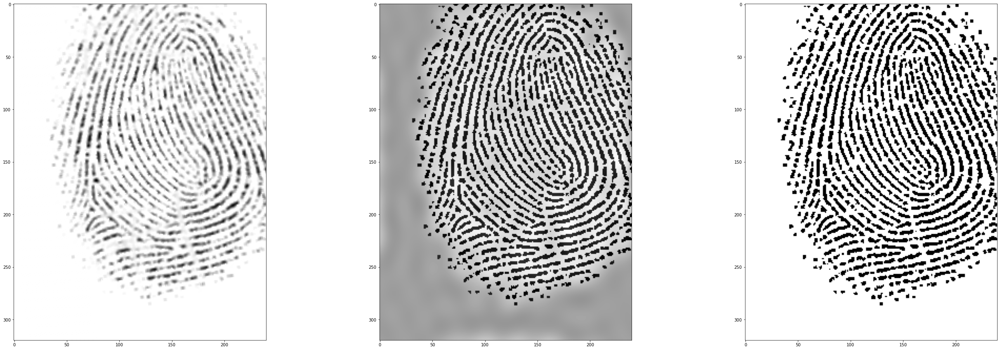

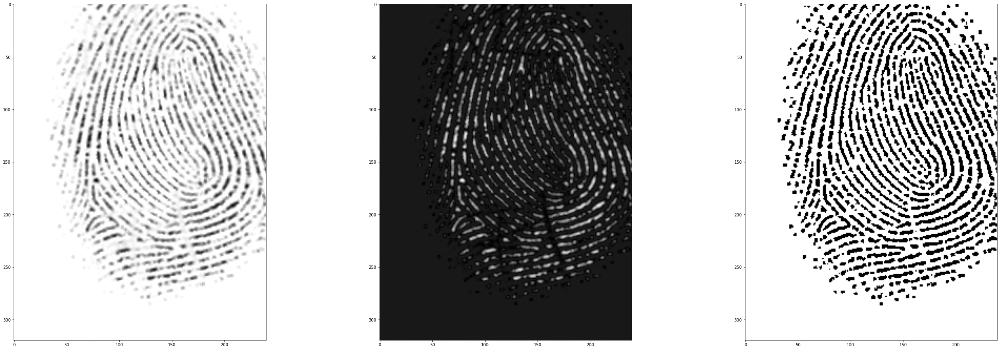

In [44]:
thumb=cv2.imread("C:/Users/brusl/Pictures/Imagenes_Opencv/105_7.tif",0)
#eq_thumb =equalitation_by_hist("105_7.tif","C:/Users/brusl/Pictures/Imagenes_Opencv/",5)
trhsd=threshold(thumb,ban=False)
P_trhsd,con=ideal_hgh_filt(trhsd, 10)
sub2print(thumb,P_trhsd,trhsd)
trhsd=threshold(thumb,ban=False)
P_trhsd,con=bandass_filt(thumb,.1,600)
sub2print(thumb,P_trhsd,trhsd)

5. Repetir el ejemplo 4.58 (pág. 288.libro de texto 3era edición) usando la imagen 7.
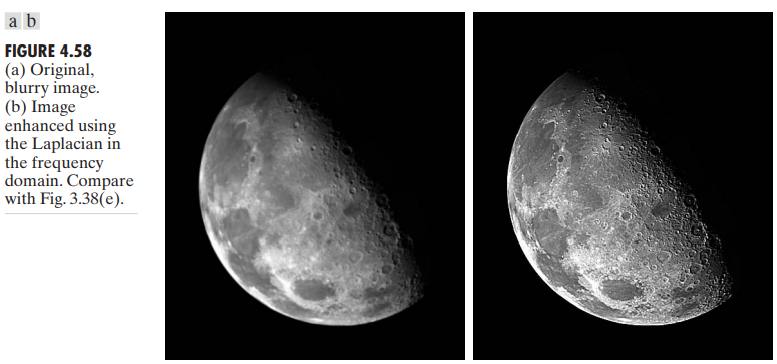

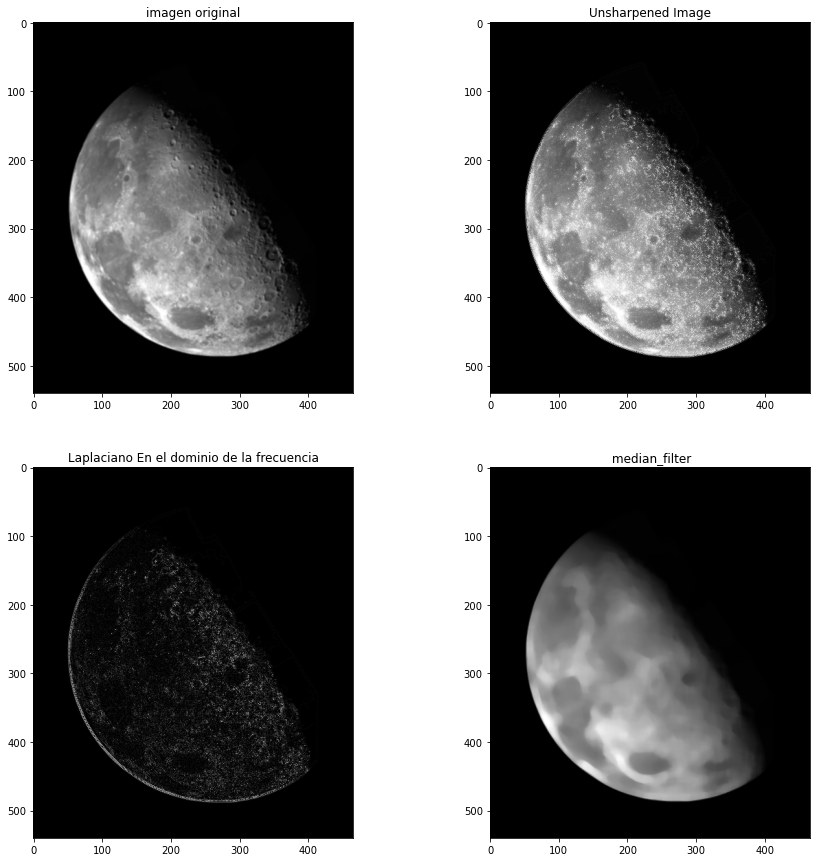

In [45]:
unsharpen_lp_frec("blurry_moon.tif","C:/Users/brusl/Pictures/Imagenes_Opencv/",intensity=1)

6. Repetir el ejemplo 4.59 (pág. 290.libro de texto 3era edición) usando la imagen 8.
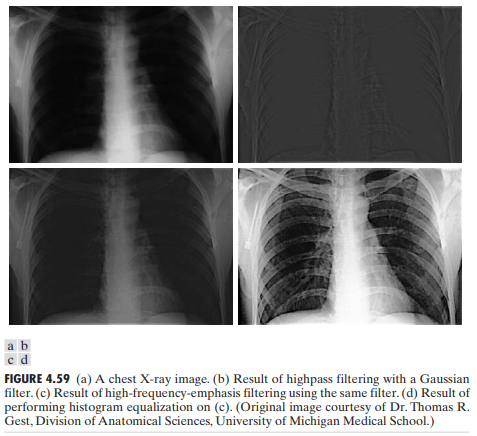

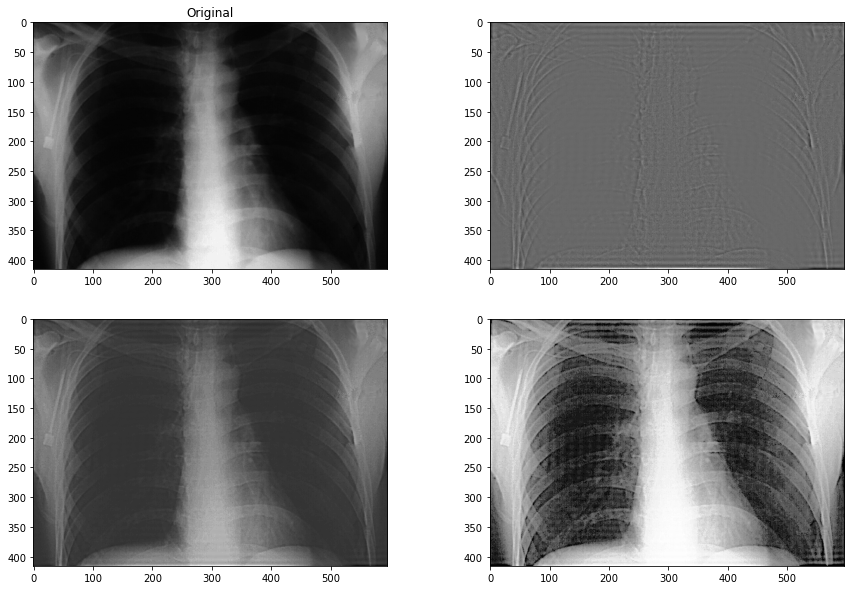

In [46]:
Fig0459=cv2.imread("C:/Users/brusl/Pictures/Imagenes_Opencv/Fig0459(a)(orig_chest_xray).tif",0)
Fig_0459,x=gauss_hg_filt(Fig0459,40)
ed=Fig0459*.5+Fig_0459*.75
cv2.imwrite("C:/Users/brusl/Pictures/Imagenes_Opencv/Trnfd.tif",cv2.convertScaleAbs(ed))
ed_Fig0459=equalitation_by_hist("Trnfd.tif","C:/Users/brusl/Pictures/Imagenes_Opencv/")
fig = plt.figure(figsize=(15, 10));rows,columns = 2,2# crear figura, establecer los valores del tamaño de los subplots
fig.add_subplot(rows, columns, 1),plt.imshow(Fig0459,cmap="gray"),plt.title("Original")
fig.add_subplot(rows, columns, 2),plt.imshow(Fig_0459,cmap="gray"),plt.title("")
fig.add_subplot(rows, columns, 3),plt.imshow(ed,cmap="gray"),plt.title("")
fig.add_subplot(rows, columns, 4),plt.imshow(ed_Fig0459,cmap="gray"),plt.title("")
plt.show()